### Capstone Project Automated End-to-End Electronic Payment Reconciliation and Advanced Analytics

Overview

This capstone project aims to automate the end-to-end electronic payment reconciliation process by seamlessly integrating data from payment gateways, merchant processors, and bank statements with Oracle/Zuora systems. The solution ensures accurate and timely matching of all transaction types—including payments, refunds, chargebacks, and chargeback reversals—while accounting for merchant processing fees and foreign exchange (FX) variances.

Key features include:

- **Automated Transaction Matching:** Streamlines reconciliation by programmatically matching transactions across multiple sources, reducing manual effort and human error.
- **Exception Management:** Implements automated detection, tracking, and reporting of discrepancies, enabling proactive resolution of reconciliation issues.
- **Daily Reconciliation:** Transitions from a monthly to a daily reconciliation cycle, allowing for faster identification and resolution of issues.
- **Real-Time Dashboards and Reporting:** Provides up-to-date visibility into reconciliation status and outstanding discrepancies through interactive dashboards and reports.
- **Error Reduction:** Minimizes manual intervention, significantly reducing the risk of reconciliation errors and improving overall process efficiency.

By automating and enhancing the reconciliation workflow, this project delivers improved accuracy, faster issue detection, and greater transparency for finance and operations teams.

### Datasets Overview

This project utilizes four key datasets, each representing a critical component of the electronic payment reconciliation process:

1. **Billing DataFrame (`billing.csv`)**  
    Contains detailed records of payment transactions, including payments, refunds, and chargeback reversals. Key fields include transaction dates, amounts, payment methods, processor IDs, and customer information. This dataset serves as the primary source for analyzing and tracking payment activity from the business system.

2. **Gateway DataFrame (`gateway.csv`)**  
    Captures transaction data from payment gateways such as PayPal, Cybersource, and GoCardless. It includes gateway transaction IDs, statuses, response codes, transaction amounts, fees, and settlement details. This dataset is essential for validating gateway-level processing and fee calculations.

3. **Merchant Processor DataFrame (`merchant_processor.csv`)**  
    Provides transaction records from merchant processors, detailing settlement, payout, and fee information. It includes processor transaction IDs, merchant account details, transaction types, fraud scores, and net settled amounts. This dataset is used to reconcile processor settlements and assess discrepancies or processing fees.

4. **Bank Statement DataFrame (`bank_statement.csv`)**  
    Represents actual bank account activity related to electronic payment settlements. It includes transaction dates, descriptions, reference numbers, amounts, balances, and transaction types. This dataset is crucial for verifying that settlements from gateways and processors are accurately reflected in the bank records.

Together, these datasets enable comprehensive, automated reconciliation by matching transactions across business, gateway, processor, and bank records, ensuring accuracy and transparency throughout the payment lifecycle.

#### Data Model Relationship Diagram

Below is a conceptual diagram illustrating the one-to-one and one-to-many relationships among the key datasets used in the end-to-end reconciliation process:

            [BILLING]───1:1───[GATEWAY]───1:1───[MERCHANT PROCESSOR]───M:1───[BANK STATEMENT]---
                │                │                   │                        │                │
                │                │                   │                        │                │
                │                │                   │                        │                │
                └───────────────► Combined into a single DataFrame: [df_end_to_end_recon] ◄─────


**Legend:**
- `1:1` = One-to-one relationship (each billing record matches at most one gateway and one merchant processor record)
- `M:1` = Many-to-one relationship (multiple merchant processor records can map to a single bank statement line)
- `[df_end_to_end_recon]` = Final DataFrame containing all key features from Billing, Gateway, Merchant Processor, and Bank Statement for each transaction

**Key Features Included:**
- **Billing:** Transaction type, date, amount, currency, payment method, processor ID, customer info
- **Gateway:** Gateway transaction ID, status, response code, amount, fees, settlement details
- **Merchant Processor:** Processor transaction ID, settlement batch, net settled amount, processor type, fees
- **Bank Statement:** Deposit date, reference number, credits, debits, currency

This unified data model enables comprehensive, automated reconciliation and advanced analytics across the entire payment lifecycle.

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import time
from ydata_profiling import ProfileReport
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score, roc_curve, precision_score, recall_score, f1_score
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer 
import sys
import ipywidgets
import warnings
warnings.filterwarnings("ignore")


In [5]:
# Load Data
# Read the billing, gateway, merchant processor, and bank statement CSV files into pandas DataFrames
df_billing = pd.read_csv('billing.csv')
df_gateway = pd.read_csv('gateway.csv')
df_merchant_processor = pd.read_csv('merchant_processor.csv')
df_bank_statement = pd.read_csv('bank_statement.csv')

In [6]:
#Sripe whitespace from column names
df_billing.columns = df_billing.columns.str.strip()
df_gateway.columns = df_gateway.columns.str.strip()
df_merchant_processor.columns = df_merchant_processor.columns.str.strip()
df_bank_statement.columns = df_bank_statement.columns.str.strip()

### 1. Billing DataFrame Overview

The `billing` DataFrame contains payment transaction records with the following columns:

- **Record_ID**: Unique identifier for each transaction.
- **Record_Type**: Type of record (e.g., payment, chargeback_reversal).
- **transaction_date**: Date of the transaction.
- **currency**: Currency code (e.g., USD, AUD).
- **customer_number**: Unique customer identifier.
- **amount**: Transaction amount.
- **Payment Method Type**: Method used for payment (e.g., PayPal, Credit Card, ACH).
- **card type**: Card brand/type if applicable (e.g., Visa, Amex, Mastercard).
- **Processor Transaction ID**: Unique ID from the payment processor.
- **Payment Gateway**: Name of the payment gateway (e.g., PayPal, Cybersource).
- **Processor Response Code**: Response code from the processor.
- **processor response message**: Message describing the processor's response.
- **Order ID / Invoice ID**: Associated order or invoice identifier.
- **Sales Channel**: Channel through which the sale was made (e.g., Online, In-Store, Phone).
- **Foreign Exchange Rate**: Exchange rate applied for the transaction.
- **created_by**: User or system that created the record.
- **creation_date**: Timestamp when the record was created.
- **comments**: Additional comments or notes about the transaction.

**Shape:** 141,250 rows × 18 columns

**Usage:**  
This DataFrame is used to analyze and reconcile payment transactions, track payment methods, and review transaction statuses and responses.

In [7]:
df_billing.head(5)  # Display the first 5 rows of the billing DataFrame

,Record_ID,Record_Type,transaction_date,currency,customer_number,amount,Payment Method Type,card type,Processor Transaction ID,Payment Gateway,Processor Response Code,processor response message,Order ID / Invoice ID,Sales Channel,Foreign Exchange Rate,created_by,creation_date,comments
0,PAY-0000000,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,NaN,PROC-21233551,PayPal,0,Approved,PAY-0000000,In-Store,1.0017,system_batch,2025-07-03 13:40:27.180132,Initial payment transaction
1,PAY-0000001,payment,2025-01-10,USD,CUST20779,4277.28,ACH,NaN,PROC-45142454,GoCardless,0,Approved,PAY-0000001,In-Store,1.0058,system_batch,2025-07-03 13:40:27.180248,Initial payment transaction
2,PAY-0000002,payment,2025-02-21,USD,CUST28404,2515.78,ACH,NaN,PROC-76309118,GoCardless,0,Approved,PAY-0000002,Phone,1.0056,system_batch,2025-07-03 13:40:27.180287,Initial payment transaction
3,PAY-0000003,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,Approved,PAY-0000003,Phone,1.2599,system_batch,2025-07-03 13:40:27.180313,Initial payment transaction
4,PAY-0000004,payment,2025-03-16,USD,CUST39746,350.01,PayPal,NaN,PROC-62414033,PayPal,0,Approved,PAY-0000004,In-Store,1.0060,system_batch,2025-07-03 13:40:27.180347,Initial payment transaction


#### 1.1 Exploratory Data Analysis with `ydata-profiling`

Comprehensive exploratory data analysis (EDA) was performed using the `ydata-profiling` library on all major datasets and the final reconciliation DataFrame. This automated profiling provides a detailed overview of data quality, distributions, correlations, and potential anomalies.


In [8]:

# Generate a profiling report for the billing DataFrame
profile = ProfileReport(df_billing, title="Billing Data Profiling Report", explorative=True)
profile.to_notebook_iframe()
# Save the profiling report to an HTML file
profile.to_file("billing_data_profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 18/18 [00:01<00:00, 15.84it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]


#### 1.2 Feature Engineering and Data Preparation for Reconciliation

To streamline the reconciliation process, we will:

- **Drop non-essential columns:**  
    Remove `Record_ID`, `created_by`, `creation_date`, and `comments` from the `billing` DataFrame, as these are supplementary and not required for reconciliation logic.

- **Fill missing card type values:**  
    Replace missing values in the `card type` column with the corresponding value from `Payment Method Type` to ensure completeness for downstream matching.

- **Rename columns**
 Order ID/ Invoice ID to Inv_Pay_Number -To standardize column naming, rename `Order ID / Invoice ID` to `Inv_Payment_Number` in the `billing` DataFrame
 Column Names prefix with BS_ for the essential columns to identify them as billing system transactions and name uniformly init cap



- **Retain only essential columns:**  
    Keep only the columns necessary for reconciliation, such as:
    - `Record_Type`
    - `transaction_date`
    - `currency`
    - `customer_number`
    - `amount`
    - `Payment Method Type`
    - `card type`
    - `Processor Transaction ID`
    - `Payment Gateway`
    - `Processor Response Code`
    - `processor response message`
    - `Order ID / Invoice ID`
    - `Sales Channel`
    - `Foreign Exchange Rate`

This focused dataset will facilitate efficient and accurate reconciliation across payment, gateway, processor, and bank records.





In [9]:
# Feature Engineering and Data Preparation for Reconciliation

# Drop non-essential columns from billing
df_billing_cleaned = df_billing.drop(columns=['Record_ID', 'created_by', 'creation_date', 'comments'], errors='ignore')

# Fill missing 'card type' values with 'Payment Method Type'
df_billing_cleaned['card type'] = df_billing_cleaned['card type'].fillna(df_billing_cleaned['Payment Method Type'])

# Rename 'Order ID / Invoice ID' to 'Inv_Payment_Number'
df_billing_cleaned = df_billing_cleaned.rename(columns={'Order ID / Invoice ID': 'Inv_Payment_Number'})

essential_columns = [
    'Record_Type',
    'transaction_date',
    'currency',
    'customer_number',
    'amount',
    'Payment Method Type',
    'card type',
    'Processor Transaction ID',
    'Payment Gateway',
    'Processor Response Code',
    'processor response message',
    'Inv_Payment_Number',
    'Sales Channel',
    'Foreign Exchange Rate'
]
# Prefix essential columns with 'BS_' and convert to Init Cap (title case, underscores preserved)
new_column_names = {}
for col in essential_columns:
    col_title = col.replace('_', ' ').title().replace(' ', '_')
    new_column_names[col] = f'BS_{col_title}'

df_billing_cleaned = df_billing_cleaned.rename(columns=new_column_names)
essential_columns_prefixed = [new_column_names[col] for col in essential_columns]

# Retain only essential columns for reconciliation
df_billing_recon = df_billing_cleaned[essential_columns_prefixed]

df_billing_recon.head()

,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,BS_Processor_Response_Message,BS_Inv_Payment_Number,BS_Sales_Channel,BS_Foreign_Exchange_Rate
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,Approved,PAY-0000000,In-Store,1.0017
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,Approved,PAY-0000001,In-Store,1.0058
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,Approved,PAY-0000002,Phone,1.0056
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,Approved,PAY-0000003,Phone,1.2599
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,Approved,PAY-0000004,In-Store,1.0060


In [10]:
df_billing_recon.shape  # Display the shape of the billing DataFrame

(141250, 14)

In [11]:
df_billing_recon.describe() # Display descriptive statistics of the billing DataFrame

,BS_Amount,BS_Foreign_Exchange_Rate
count,141250.000000,141250.000000
mean,1979.220766,0.992354
std,2112.685001,0.150630
min,-4999.850000,0.653400
25%,828.465000,0.993300
50%,2221.170000,1.001600
75%,3607.442500,1.010000
max,4999.870000,1.282700


In [12]:
df_billing_recon.info()  # Display information about the billing DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   BS_Record_Type                 141250 non-null  object 
 1   BS_Transaction_Date            141250 non-null  object 
 2   BS_Currency                    141250 non-null  object 
 3   BS_Customer_Number             141250 non-null  object 
 4   BS_Amount                      141250 non-null  float64
 5   BS_Payment_Method_Type         141250 non-null  object 
 6   BS_Card_Type                   141250 non-null  object 
 7   BS_Processor_Transaction_Id    141250 non-null  object 
 8   BS_Payment_Gateway             141250 non-null  object 
 9   BS_Processor_Response_Code     141250 non-null  object 
 10  BS_Processor_Response_Message  141250 non-null  object 
 11  BS_Inv_Payment_Number          141250 non-null  object 
 12  BS_Sales_Channel              

### 2. Gateway DataFrame Overview

The `gateway` DataFrame contains transaction records from payment gateways with the following columns:

- **Gateway Transaction ID**: Unique identifier for each gateway transaction.
- **Payment Gateway Name**: Name of the payment gateway (e.g., PayPal, Cybersource, GoCardless).
- **Transaction Status**: Status of the transaction (e.g., settled, disputed).
- **Gateway Response Code**: Response code returned by the gateway.
- **Gateway Response Message**: Message describing the gateway's response.
- **Transaction Amount**: Amount processed in the transaction.
- **Transaction Currency**: Currency code for the transaction (e.g., USD, AUD).
- **Transaction Type**: Type of transaction (e.g., payment, chargeback_reversal).
- **Card Brand**: Brand of the card used (if applicable).
- **Card Last 4 Digits**: Last four digits of the card number (if applicable).
- **Card Type**: Type of card (e.g., Credit).
- **Token ID**: Tokenized identifier for the payment method.
- **Bank Account Type**: Type of bank account (if applicable).
- **Bank Name**: Name of the bank (if applicable).
- **PayPal Payer ID**: Identifier for PayPal payer (if applicable).
- **AVS Result Code**: Address Verification Service result.
- **CVV Result Code**: Card Verification Value result.
- **Authorization Code**: Code returned upon transaction authorization.
- **Gateway Timestamp**: Timestamp of the transaction at the gateway.
- **Gateway Fees**: Fees charged by the gateway for the transaction.
- **Net Settled Amount**: Amount settled after gateway fees.
- **Acquirer Reference Number (ARN)**: Reference number for settlement (if applicable).
- **reference_number**: Reference to the original transaction or order.

**Shape:** 141,250 rows × 23 columns

**Usage:**  
This DataFrame is used to analyze gateway-level transaction details, review responses and statuses, calculate fees, and reconcile transactions with other payment records.

In [13]:
df_gateway.head(5)  # Display the first 5 rows of the gateway DataFrame

,Gateway Transaction ID,Payment Gateway Name,Transaction Status,Gateway Response Code,Gateway Response Message,Transaction Amount,Transaction Currency,Transaction Type,Card Brand,Card Last 4 Digits,...,Bank Name,PayPal Payer ID,AVS Result Code,CVV Result Code,Authorization Code,Gateway Timestamp,Gateway Fees,Net Settled Amount,Acquirer Reference Number (ARN),reference_number
0,GW-TRX-9972261,PayPal,settled,0,Approved,2592.98,USD,payment,NaN,NaN,...,NaN,PAYPAL_68156,NaN,NaN,AUTH698092,2025-01-30,19.45,2573.53,NaN,PAY-0000000
1,GW-TRX-8455695,GoCardless,settled,0,Approved,4277.28,USD,payment,NaN,NaN,...,Bank of Example,NaN,NaN,NaN,AUTH259525,2025-01-10,10.69,4266.59,NaN,PAY-0000001
2,GW-TRX-5184318,GoCardless,settled,0,Approved,2515.78,USD,payment,NaN,NaN,...,Bank of Example,NaN,NaN,NaN,AUTH662545,2025-02-21,6.29,2509.49,NaN,PAY-0000002
3,GW-TRX-8104962,Cybersource,settled,0,Approved,2874.81,GBP,payment,Visa,9887.0,...,NaN,NaN,Y,M,AUTH779374,2025-01-04,28.75,2846.06,ARN618188908,PAY-0000003
4,GW-TRX-2770667,PayPal,settled,0,Approved,350.01,USD,payment,NaN,NaN,...,NaN,PAYPAL_39472,NaN,NaN,AUTH375526,2025-03-16,2.63,347.38,NaN,PAY-0000004


In [14]:
df_gateway.info()  # Display information about the gateway DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 23 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   Gateway Transaction ID           141250 non-null  object 
 1   Payment Gateway Name             141250 non-null  object 
 2   Transaction Status               141250 non-null  object 
 3   Gateway Response Code            141250 non-null  object 
 4   Gateway Response Message         141250 non-null  object 
 5   Transaction Amount               141250 non-null  float64
 6   Transaction Currency             141250 non-null  object 
 7   Transaction Type                 141250 non-null  object 
 8   Card Brand                       47296 non-null   object 
 9   Card Last 4 Digits               47296 non-null   float64
 10  Card Type                        47296 non-null   object 
 11  Token ID                         94406 non-null   object 
 12  Ba

In [15]:
df_gateway.shape  # Display the shape of the gateway DataFrame

(141250, 23)

#### 2.1 Exploratory Data Analysis(EDA) and Data Preparation for `Gateway.csv`

This section provides an overview and exploratory analysis of the `df_gateway` DataFrame, which contains transaction records from payment gateways.

**Key Areas of Analysis:**

- **Transaction Status Distribution:**  
    - Count and proportion of each transaction status (e.g., settled, disputed).

- **Transaction Amounts:**  
    - Summary statistics (mean, median, min, max) for transaction amounts.
    - Distribution of transaction amounts by currency.

- **Payment Gateway Breakdown:**  
    - Number and total value of transactions by payment gateway (e.g., PayPal, Cybersource, GoCardless).

- **Transaction Types:**  
    - Distribution of transaction types (e.g., payment, chargeback_reversal).

- **Gateway Fees and Net Settled Amounts:**  
    - Analysis of gateway fees and net settled amounts across gateways and currencies.

- **Response Codes and Messages:**  
    - Most common gateway response codes and messages.

**Suggested Visualizations:**

- Bar plots for transaction status and gateway name distributions.
- Boxplots or histograms for transaction amounts.
- Pie charts for transaction type proportions.
- Scatter plots or bar charts for gateway fees vs. net settled amounts.

These analyses help identify trends, outliers, and potential data quality issues in gateway-level payment processing.

In [16]:
# Generate a profiling report for the gateway DataFrame using ydata-profiling
profile_gateway = ProfileReport(df_gateway, title="Gateway Data Profiling Report", explorative=True)
profile_gateway.to_notebook_iframe()
profile_gateway.to_file("gateway_data_profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 23/23 [00:00<00:00, 28.23it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]


#### 2.2 Feature Data Engineering and Gateway Data Preparation, and Joining with Billing Data

**1. Column Renaming:**  
The following columns in the `gateway` DataFrame are renamed for clarity and consistency:
- `Gateway Transaction ID` → `GW_Transaction_ID`
- `Gateway Response Message` → `GW_Response`
- `Transaction Amount` → `GW_Transaction_Amount`
- `Payment Gateway Name` → `GW_name`
- `Gateway Fees` → `GW_fees`
- `Net Settled Amount` → `GW_Net_Settled_Amt`
- `Gateway Timestamp` → `GW_Trx_Date`
- `reference_number` → `GW_Ref_Number`

**2. Card Brand Imputation:**  
Missing values in the `Card Brand` column are filled with the corresponding `GW_name` value to ensure completeness for downstream matching.

**3. Essential Columns Selection:**  
Only the following essential columns are retained for reconciliation:
- `GW_Transaction_ID`
- `GW_name`
- `Transaction Status`
- `Gateway Response Code`
- `GW_Response`
- `GW_Transaction_Amount`
- `Transaction Currency`
- `Transaction Type`
- `Card Brand`
- `GW_fees`
- `GW_Net_Settled_Amt`
- `GW_Trx_Date`
- `GW_Ref_Number`

**4. DataFrame Join and Match Flag:**  
A new DataFrame, `df_payment_recon`, is created by joining `df_billing_recon` with the essential gateway columns using the following keys:
- `BS_Inv_Payment_Number` ↔ `GW_Ref_Number`
- `BS_Amount` ↔ `GW_Transaction_Amount`
- `BS_Currency` ↔ `Transaction Currency`
- `BS_Transaction_Date` ↔ `GW_Trx_Date`

A new column, `BS_GW_Match`, is added to indicate whether a match was found (`Yes`) or not (`No`) for each billing record.

 

In [17]:
# 1) Rename gateway columns as specified
gateway_renamed = df_gateway.rename(columns={
    'Gateway Transaction ID': 'GW_Transaction_ID',
    'Gateway Response Message': 'GW_Response',
    'Transaction Amount': 'GW_Transaction_Amount',
    'Payment Gateway Name': 'GW_name',
    'Gateway Fees': 'GW_fees',
    'Net Settled Amount': 'GW_Net_Settled_Amt',
    'Gateway Timestamp': 'GW_Trx_Date',
    'reference_number': 'GW_Ref_Number',
    'Gateway Response Code': 'GW_Response_Code',  # keep as in gateway_essential_cols
    'Transaction Status': 'GW_Transaction_Status',  # keep as in gateway_essential_cols
    'Transaction Currency': 'GW_Trx_Currency',  # keep as in gateway_essential_cols
    'Card Brand': 'GW_Card_Brand',                      # keep as in gateway_essential_cols
    'Transaction Type': 'GW_Trx_Type'           # keep as in gateway_essential_cols
})

# 2) Populate missing values in 'Card Brand' with 'GW_name'
if 'GW_Card_Brand' in gateway_renamed.columns and 'GW_name' in gateway_renamed.columns:
    gateway_renamed['GW_Card_Brand'] = gateway_renamed['GW_Card_Brand'].fillna(gateway_renamed['GW_name'])

# 3) Retain only essential columns for joining
gateway_essential_cols = [
    'GW_Transaction_ID', 'GW_name', 'GW_Transaction_Status', 'GW_Response_Code', 'GW_Response',
    'GW_Transaction_Amount', 'GW_Trx_Currency', 'GW_Trx_Type', 'GW_Card_Brand',
    'GW_fees', 'GW_Net_Settled_Amt', 'GW_Trx_Date', 'GW_Ref_Number'
]
gateway_essential = gateway_renamed[gateway_essential_cols]
# Ensure data types match for join keys to avoid merge issues
df_billing_recon['BS_Amount'] = pd.to_numeric(df_billing_recon['BS_Amount'], errors='coerce')
gateway_essential['GW_Transaction_Amount'] = pd.to_numeric(gateway_essential['GW_Transaction_Amount'], errors='coerce')
# 4) Merge with df_billing_recon on multiple keys and add BS_GW_Match column
df_payment_recon = df_billing_recon.merge(
    gateway_essential,
    left_on=['BS_Inv_Payment_Number', 'BS_Amount', 'BS_Currency', 'BS_Transaction_Date'],
    right_on=['GW_Ref_Number', 'GW_Transaction_Amount', 'GW_Trx_Currency', 'GW_Trx_Date'],
    how='left',
    suffixes=('', '_GW')
)

df_payment_recon['BS_GW_Match'] = df_payment_recon['GW_Transaction_ID'].notnull().map({True: 'Yes', False: 'No'})

df_payment_recon.head()


,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,...,GW_Response,GW_Transaction_Amount,GW_Trx_Currency,GW_Trx_Type,GW_Card_Brand,GW_fees,GW_Net_Settled_Amt,GW_Trx_Date,GW_Ref_Number,BS_GW_Match
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,...,Approved,2592.98,USD,payment,PayPal,19.45,2573.53,2025-01-30,PAY-0000000,Yes
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,...,Approved,4277.28,USD,payment,GoCardless,10.69,4266.59,2025-01-10,PAY-0000001,Yes
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,...,Approved,2515.78,USD,payment,GoCardless,6.29,2509.49,2025-02-21,PAY-0000002,Yes
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,...,Approved,2874.81,GBP,payment,Visa,28.75,2846.06,2025-01-04,PAY-0000003,Yes
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,...,Approved,350.01,USD,payment,PayPal,2.63,347.38,2025-03-16,PAY-0000004,Yes


### 3. Merchant Processor DataFrame Overview

The `merchant_processor` DataFrame contains transaction records from merchant processors with the following columns:

- **Processor Transaction ID**: Unique identifier for each processor transaction.
- **Merchant Account ID**: Identifier for the merchant's account.
- **Merchant Processor Type**: Type of processor (e.g., PayPal, Cybersource, GoCardless).
- **Transaction Type**: Nature of the transaction (e.g., payment, chargeback_reversal).
- **Transaction Status**: Status of the transaction (e.g., settled, disputed).
- **Transaction Amount**: Amount processed in the transaction.
- **Transaction Currency**: Currency code (e.g., USD, AUD).
- **Processor Response Code**: Response code from the processor.
- **Processor Response Message**: Message describing the processor's response.
- **Payment Method Type**: Method used for payment (e.g., PayPal, Credit Card, ACH).
- **Card Brand**: Brand of the card used (if applicable).
- **Card Last 4 Digits**: Last four digits of the card number (if applicable).
- **Card Expiration Date**: Expiry date of the card.
- **Bank Name**: Name of the bank (if applicable).
- **Bank Account Type**: Type of bank account (if applicable).
- **Payment Method Token**: Tokenized identifier for the payment method.
- **Merchant Order ID**: Associated order or invoice identifier.
- **Customer ID**: Unique customer identifier.
- **AVS Result Code**: Address Verification Service result.
- **CVV/CVC Result Code**: Card Verification Value result.
- **Fraud Score**: Score indicating potential fraud risk.
- **Fraud Action**: Action taken based on fraud assessment.
- **Gateway Net Settled Amount**: Amount settled after gateway fees.
- **Processor Fees**: Fees charged by the processor.
- **Net Amount to Merchant**: Final amount credited to the merchant.
- **Settlement Batch ID**: Identifier for the settlement batch.
- **Settlement Date**: Date of settlement.
- **Acquirer Reference Number (ARN)**: Reference number for settlement (if applicable).
- **Transaction Timestamp**: Timestamp of the transaction.
- **Last Update Timestamp**: Last update time for the transaction record.
- **Payment Gateway Date**: Date at the payment gateway.
- **Payout Date**: Date funds were paid out.
- **Payment Gateway Type**: Type of payment gateway.

**Shape:** 141,250 rows × 33 columns

**Usage:**  
This DataFrame is used to analyze processor-level transaction details, review settlement and payout information, calculate fees, assess fraud risk, and reconcile transactions with other payment records.

In [18]:
df_merchant_processor.head(5)  # Display the first 5 rows of the merchant processor DataFrame

,Processor Transaction ID,Merchant Account ID,Merchant Processor Type,Transaction Type,Transaction Status,Transaction Amount,Transaction Currency,Processor Response Code,Processor Response Message,Payment Method Type,...,Processor Fees,Net Amount to Merchant,Settlement Batch ID,Settlement Date,Acquirer Reference Number (ARN),Transaction Timestamp,Last Update Timestamp,Payment Gateway Date,Payout Date,Payment Gateway Type
0,PROC-TRX-96148747,MERCH_PAYPAL_USD,PayPal,payment,settled,2592.98,USD,0,Approved,PayPal,...,0.00,2573.53,SET-20250130-PayPal-N/A-USD,2025-01-31,NaN,2025-01-30,2025-01-30,2025-01-30,2025-01-31,PayPal
1,PROC-TRX-53756634,MERCH_GOCARDLESS_USD,GoCardless,payment,settled,4277.28,USD,0,Approved,ACH,...,0.00,4266.59,SET-20250110-GoCardless-N/A-USD,2025-01-13,NaN,2025-01-10,2025-01-10,2025-01-10,2025-01-13,GoCardless
2,PROC-TRX-96643401,MERCH_GOCARDLESS_USD,GoCardless,payment,settled,2515.78,USD,0,Approved,ACH,...,0.00,2509.49,SET-20250221-GoCardless-N/A-USD,2025-02-24,NaN,2025-02-21,2025-02-21,2025-02-21,2025-02-24,GoCardless
3,PROC-TRX-48503361,MERCH_CYBERSOURCE_GBP,ClientLine,payment,settled,2874.81,GBP,0,Approved,Credit Card,...,28.75,2817.31,SET-20250104-ClientLine-Visa-GBP,2025-01-07,ARN618188908,2025-01-04,2025-01-04,2025-01-04,2025-01-07,Cybersource
4,PROC-TRX-87613870,MERCH_PAYPAL_USD,PayPal,payment,settled,350.01,USD,0,Approved,PayPal,...,0.00,347.38,SET-20250316-PayPal-N/A-USD,2025-03-19,NaN,2025-03-16,2025-03-16,2025-03-16,2025-03-19,PayPal


In [19]:
df_merchant_processor.info()  # Display information about the merchant processor DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 33 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   Processor Transaction ID         141250 non-null  object 
 1   Merchant Account ID              141250 non-null  object 
 2   Merchant Processor Type          141250 non-null  object 
 3   Transaction Type                 141250 non-null  object 
 4   Transaction Status               141250 non-null  object 
 5   Transaction Amount               141250 non-null  float64
 6   Transaction Currency             141250 non-null  object 
 7   Processor Response Code          141250 non-null  object 
 8   Processor Response Message       141250 non-null  object 
 9   Payment Method Type              141250 non-null  object 
 10  Card Brand                       47296 non-null   object 
 11  Card Last 4 Digits               47296 non-null   float64
 12  Ca

In [20]:
df_merchant_processor.shape  # Display the shape of the merchant processor DataFrame

(141250, 33)

### 3.1 Exploratory Data Analysis for Merchant Processor

This section provides an overview and exploratory analysis of the `merchant_processor` DataFrame, which contains transaction records from merchant processors.

These analyses help identify trends, outliers, and potential data quality issues in processor-level payment processing and support reconciliation with other payment records.

In [21]:
# Generate a profiling report for the Merchant Processor DataFrame using ydata-profiling
profile_gateway = ProfileReport(df_merchant_processor, title="Merchant Processor Data Profiling Report", explorative=True)
#profile_gateway.to_notebook_iframe()
profile_gateway.to_file("merchant_processor_data_profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 33/33 [00:01<00:00, 27.06it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### 3.2 Merchant Processor Data Preparation and Joining with Payment Reconciliation

**1. Column Renaming:**  
The following columns in the `merchant_processor` DataFrame are renamed for clarity and consistency:
- `Processor Transaction ID` → `MP_Trx_ID`
- `Merchant Processor Type` → `MP_Processor_Type`
- `Transaction Type` → `MP_Trx_Type`
- `Processor Fees` → `MP_Processor_Fee`
- `Transaction Currency` → `MP_Trx_Currency`
- `Net Amount to Merchant` → `MP_Settled_Amount`
- `Settlement Batch ID` → `MP_Settlement_Batch`
- `Merchant Order ID` → `MP_Order_ID`
- `Settlement Date` → `MP_Settlement_Date`

**2. Card Brand Imputation:**  
Missing values in the `Card Brand` column are filled with the corresponding `Payment Method Type` value to ensure completeness for downstream matching.

**3. Essential Columns Selection:**  
Only the following essential columns are retained for reconciliation:
- `MP_Trx_ID`
- `MP_Processor_Type`
- `MP_Trx_Type`
- `MP_Processor_Fee`
- `MP_Settled_Amount`
- `MP_Settlement_Date`
- `MP_Settlement_Batch`
- `MP_Trx_Currency`
- `MP_Order_ID`

**4. DataFrame Join and Match Flag:**  
A new DataFrame, `df_bs_pg_mp_recon`, is created by joining `df_payment_recon` with the essential merchant processor columns using the following keys:
- `BS_Record_Type` ↔ `MP_Trx_Type`
- `BS_Currency` ↔ `MP_Trx_Currency`
- `BS_Inv_Payment_Number` ↔ `MP_Order_ID`

A new column, `PG_MP_Match`, is added to indicate whether a match was found (`Yes`) or not (`No`) for each payment record.



In [22]:
# 1) Rename columns in merchant_processor as specified
df_mp_renamed = df_merchant_processor.rename(columns={
    'Processor Transaction ID': 'MP_Trx_ID',
    'Merchant Processor Type': 'MP_Processor_Type',
    'Transaction Type': 'MP_Trx_Type',
    'Processor Fees': 'MP_Processor_Fee',
    'Transaction Currency': 'MP_Trx_Currency',
    'Net Amount to Merchant': 'MP_Settled_Amount',
    'Settlement Batch ID': 'MP_Settlement_Batch',
    'Merchant Order ID': 'MP_Order_ID',
    'Settlement Date': 'MP_Settlement_Date'
})

# 2) Fill missing 'Card Brand' with 'Payment Method Type'
df_mp_renamed['Card Brand'] = df_mp_renamed['Card Brand'].fillna(df_mp_renamed['Payment Method Type'])

# 3) Retain only essential columns for reconciliation
mp_essential_cols = [
    'MP_Trx_ID', 'MP_Processor_Type', 'MP_Trx_Type', 'MP_Processor_Fee',
    'MP_Settled_Amount', 'MP_Settlement_Date', 'MP_Settlement_Batch',
    'MP_Trx_Currency', 'MP_Order_ID'
]
mp_essential = df_mp_renamed[mp_essential_cols]

# 4) Merge with df_payment_recon on transaction type, currency, and order ID
df_bs_pg_mp_recon = df_payment_recon.merge(
    mp_essential,
    left_on=['BS_Record_Type', 'BS_Currency', 'BS_Inv_Payment_Number'],
    right_on=['MP_Trx_Type', 'MP_Trx_Currency', 'MP_Order_ID'],
    how='left'
)

df_bs_pg_mp_recon['PG_MP_Match'] = df_bs_pg_mp_recon['MP_Trx_ID'].notnull().map({True: 'Yes', False: 'No'})

df_bs_pg_mp_recon.head()

,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,...,MP_Trx_ID,MP_Processor_Type,MP_Trx_Type,MP_Processor_Fee,MP_Settled_Amount,MP_Settlement_Date,MP_Settlement_Batch,MP_Trx_Currency,MP_Order_ID,PG_MP_Match
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,...,PROC-TRX-96148747,PayPal,payment,0.00,2573.53,2025-01-31,SET-20250130-PayPal-N/A-USD,USD,PAY-0000000,Yes
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,...,PROC-TRX-53756634,GoCardless,payment,0.00,4266.59,2025-01-13,SET-20250110-GoCardless-N/A-USD,USD,PAY-0000001,Yes
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,...,PROC-TRX-96643401,GoCardless,payment,0.00,2509.49,2025-02-24,SET-20250221-GoCardless-N/A-USD,USD,PAY-0000002,Yes
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,...,PROC-TRX-48503361,ClientLine,payment,28.75,2817.31,2025-01-07,SET-20250104-ClientLine-Visa-GBP,GBP,PAY-0000003,Yes
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,...,PROC-TRX-87613870,PayPal,payment,0.00,347.38,2025-03-19,SET-20250316-PayPal-N/A-USD,USD,PAY-0000004,Yes


In [23]:
df_bs_pg_mp_recon.info()  # Display information about the merchant processor DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 38 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   BS_Record_Type                 141250 non-null  object 
 1   BS_Transaction_Date            141250 non-null  object 
 2   BS_Currency                    141250 non-null  object 
 3   BS_Customer_Number             141250 non-null  object 
 4   BS_Amount                      141250 non-null  float64
 5   BS_Payment_Method_Type         141250 non-null  object 
 6   BS_Card_Type                   141250 non-null  object 
 7   BS_Processor_Transaction_Id    141250 non-null  object 
 8   BS_Payment_Gateway             141250 non-null  object 
 9   BS_Processor_Response_Code     141250 non-null  object 
 10  BS_Processor_Response_Message  141250 non-null  object 
 11  BS_Inv_Payment_Number          141250 non-null  object 
 12  BS_Sales_Channel              

In [24]:

df_bs_pg_mp_recon.shape # Display the shape of the merchant processor DataFrame

(141250, 38)

### 4. Bank Statement DataFrame Overview

The `bank_statement` DataFrame contains records of bank account transactions related to electronic payment settlements. The columns include:

- **Date**: Date of the transaction.
- **Description**: Brief description of the transaction (e.g., Settlement from Amex).
- **Details**: Additional details, such as batch or payout information.
- **Reference Number**: Unique reference for the transaction.
- **Check Number**: Check number if applicable (mostly NaN for electronic payments).
- **Withdrawals**: Amount withdrawn from the account.
- **Debits**: Debit transactions.
- **Payments**: Payment transactions.
- **Deposits**: Amount deposited into the account.
- **Credits**: Credit transactions.
- **Amount**: Transaction amount (positive for deposits/credits, negative for withdrawals/debits).
- **Balance**: Account balance after the transaction.
- **Running Balance**: Cumulative running balance.
- **Transaction Type**: Type of transaction (e.g., ACH).
- **Currency**: Currency code (e.g., USD, AUD, GBP).

**Shape:** 2,175 rows × 15 columns

**Usage:**  
This DataFrame is used to track and reconcile bank account activity, verify settlement amounts, and ensure that electronic payment transactions are accurately reflected in the bank records.

In [25]:
df_bank_statement.head(5)  # Display the first 5 rows of the bank statement

,Date,Description,Details,Reference Number,Check Number,Withdrawals,Debits,Payments,Deposits,Credits,Amount,Balance,Running Balance,Transaction Type,Currency
0,2025-01-03,Settlement from Amex,Processor Payout Batch,SET-20250101-Amex-Amex-AUD,NaN,0,0,0,15222.22,15222.22,15222.22,1015222.22,1015222.22,ACH,AUD
1,2025-01-03,Settlement from PayPal,Processor Payout Batch,SET-20250101-PayPal-N/A-USD,NaN,0,0,0,678343.79,678343.79,678343.79,1693566.01,1693566.01,ACH,USD
2,2025-01-03,Settlement from PayPal,Processor Payout Batch,SET-20250101-PayPal-N/A-GBP,NaN,0,0,0,102989.59,102989.59,102989.59,1796555.60,1796555.60,ACH,GBP
3,2025-01-03,Settlement from PayPal,Processor Payout Batch,SET-20250101-PayPal-N/A-EUR,NaN,0,0,0,168351.52,168351.52,168351.52,1964907.12,1964907.12,ACH,EUR
4,2025-01-03,Settlement from PayPal,Processor Payout Batch,SET-20250101-PayPal-N/A-CAD,NaN,0,0,0,82463.12,82463.12,82463.12,2047370.24,2047370.24,ACH,CAD


In [26]:
df_bank_statement.info() # Display information about the bank statement DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2175 entries, 0 to 2174
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Date              2175 non-null   object 
 1   Description       2175 non-null   object 
 2   Details           2175 non-null   object 
 3   Reference Number  2175 non-null   object 
 4   Check Number      0 non-null      float64
 5   Withdrawals       2175 non-null   int64  
 6   Debits            2175 non-null   int64  
 7   Payments          2175 non-null   int64  
 8   Deposits          2175 non-null   float64
 9   Credits           2175 non-null   float64
 10  Amount            2175 non-null   float64
 11  Balance           2175 non-null   float64
 12  Running Balance   2175 non-null   float64
 13  Transaction Type  2175 non-null   object 
 14  Currency          2175 non-null   object 
dtypes: float64(6), int64(3), object(6)
memory usage: 255.0+ KB


In [27]:
df_bank_statement.shape  # Display the shape of the bank statement DataFrame

(2175, 15)


#### 4.1 Exploratory Data Analysis for Bank Statement

This section provides an overview and exploratory analysis of the `bank_statement` DataFrame, which contains records of bank account transactions related to electronic payment settlements.


These analyses help validate the completeness and quality of the bank statement data, support reconciliation, and provide insights into banking operations.

In [28]:
# Generate a profiling report for the bank statement DataFrame using ydata-profiling
profile_bank = ProfileReport(df_bank_statement, title="Bank Statement Data Profiling Report", explorative=True)
#profile_bank.to_notebook_iframe()
profile_bank.to_file("bank_statement_data_profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 15/15 [00:00<00:00, 1467.12it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]


#### 4.2 Bank Statement Data Preparation and Creation of End-to-End Reconciliation Data Frame

**1. Column Renaming:**  
Rename the following columns in the `bank_statement` DataFrame for clarity and consistency:
- `Date` → `Bank_Deposit_Date`
- `Currency` → `Bank_Deposit_Currency`
- `Reference Number` → `Bank_Deposit_Ref_Number`
- `Deposits` → `Bank_Credits`
- `Debits` → `Bank_Debits`

**2. Essential Columns Selection:**  
Retain only the essential columns required for reconciliation:
- `Bank_Deposit_Date`
- `Bank_Deposit_Currency`
- `Bank_Deposit_Ref_Number`
- `Bank_Credits`
- `Bank_Debits`

**3. End-to-End Reconciliation DataFrame:**  
Create a new DataFrame, `df_end_to_end_recon`, by merging all columns from `df_bs_pg_mp_recon` with the essential bank columns.  
Add a new column, `end_to_end_recon_match`, and set its value to `Yes` if:
- a matching bank statement record is found (i.e., `Bank_Deposit_Ref_Number` is not null), **and**
- `BS_GW_Match` is `Yes`, **and**
- `PG_MP_Match` is `Yes`;  
otherwise, set it to `No`.


In [29]:

# 1) Rename columns in bank_statement as specified
bank_statement_renamed = df_bank_statement.rename(columns={
    'Date': 'Bank_Deposit_Date',
    'Currency': 'Bank_Deposit_Currency',
    'Reference Number': 'Bank_Deposit_Ref_Number',
    'Deposits': 'Bank_Credits',
    'Debits': 'Bank_Debits'
})

# 2) Retain only essential columns
bank_essential_cols = [
    'Bank_Deposit_Date',
    'Bank_Deposit_Currency',
    'Bank_Deposit_Ref_Number',
    'Bank_Credits',
    'Bank_Debits'
]
bank_essential = bank_statement_renamed[bank_essential_cols]

# 3 & 4) Merge with df_bs_pg_mp_recon and add end_to_end_recon_match
# df_end_to_end_recon = df_bs_pg_mp_recon.merge(
#     bank_essential,
#     left_on=['MP_Settment_Batch'],
#     right_on=['Bank_Deposit_Ref_Number'],
#     # left_on=['MP_Settlement_Date', 'MP_Trx_Currency', 'MP_Settlement_Batch'],
#     # right_on=['Bank_Deposit_Date', 'Bank_Deposit_Currency', 'Bank_Deposit_Ref_Number'],
#     how='left'
# )
# Fix typo in merge key: should be 'MP_Settlement_Batch' (not 'MP_Settment_Batch')
df_end_to_end_recon = df_bs_pg_mp_recon.merge(
    bank_essential,
    left_on=['MP_Settlement_Batch'],
    right_on=['Bank_Deposit_Ref_Number'],
    how='left'
)
df_end_to_end_recon['end_to_end_recon_match'] = (
    (df_end_to_end_recon['Bank_Deposit_Ref_Number'].notnull()) &
    (df_end_to_end_recon['BS_GW_Match'] == 'Yes') &
    (df_end_to_end_recon['PG_MP_Match'] == 'Yes')
).map({True: 'Yes', False: 'No'})

df_end_to_end_recon.head()

,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,...,MP_Settlement_Batch,MP_Trx_Currency,MP_Order_ID,PG_MP_Match,Bank_Deposit_Date,Bank_Deposit_Currency,Bank_Deposit_Ref_Number,Bank_Credits,Bank_Debits,end_to_end_recon_match
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,...,SET-20250130-PayPal-N/A-USD,USD,PAY-0000000,Yes,2025-02-03,USD,SET-20250130-PayPal-N/A-USD,584871.77,0.0,Yes
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,...,SET-20250110-GoCardless-N/A-USD,USD,PAY-0000001,Yes,2025-01-14,USD,SET-20250110-GoCardless-N/A-USD,621022.33,0.0,Yes
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,...,SET-20250221-GoCardless-N/A-USD,USD,PAY-0000002,Yes,2025-02-25,USD,SET-20250221-GoCardless-N/A-USD,655334.98,0.0,Yes
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,...,SET-20250104-ClientLine-Visa-GBP,GBP,PAY-0000003,Yes,2025-01-08,GBP,SET-20250104-ClientLine-Visa-GBP,38585.64,0.0,Yes
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,...,SET-20250316-PayPal-N/A-USD,USD,PAY-0000004,Yes,2025-03-20,USD,SET-20250316-PayPal-N/A-USD,681556.78,0.0,Yes


In [30]:
df_end_to_end_recon.info()  # Display information about the end-to-end reconciliation DataFrame
df_end_to_end_recon.shape  # Display the shape of the end-to-end reconciliation DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 44 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   BS_Record_Type                 141250 non-null  object 
 1   BS_Transaction_Date            141250 non-null  object 
 2   BS_Currency                    141250 non-null  object 
 3   BS_Customer_Number             141250 non-null  object 
 4   BS_Amount                      141250 non-null  float64
 5   BS_Payment_Method_Type         141250 non-null  object 
 6   BS_Card_Type                   141250 non-null  object 
 7   BS_Processor_Transaction_Id    141250 non-null  object 
 8   BS_Payment_Gateway             141250 non-null  object 
 9   BS_Processor_Response_Code     141250 non-null  object 
 10  BS_Processor_Response_Message  141250 non-null  object 
 11  BS_Inv_Payment_Number          141250 non-null  object 
 12  BS_Sales_Channel              

(141250, 44)

In [31]:
# To count the occurrences of each value in the 'end_to_end_recon_match' column:
df_end_to_end_recon['end_to_end_recon_match'].value_counts()

end_to_end_recon_match
Yes    120888
No      20362
Name: count, dtype: int64

In [32]:
# To count the occurance of Billing and Gateway Match record 
df_end_to_end_recon['BS_GW_Match'].value_counts()

BS_GW_Match
Yes    126250
No      15000
Name: count, dtype: int64

In [33]:
# To count the occurance of Payment Gateway and Mechant Processor record 
df_end_to_end_recon['PG_MP_Match'].value_counts()

PG_MP_Match
Yes    125000
No      16250
Name: count, dtype: int64

### 5. Exploratory Data Analysis for `df_end_to_end_recon`

This section provides an overview and exploratory analysis of the `df_end_to_end_recon` DataFrame, which represents the final, end-to-end reconciliation results across all payment data sources.

**Key Points of Analysis:**

- **Reconciliation Match Status:**  
    - Distribution of records where full reconciliation was achieved (`end_to_end_recon_match = Yes`) versus those with incomplete matches.
    - Breakdown of intermediate match flags:  
        - `BS_GW_Match`: Billing ↔ Gateway match status  
        - `PG_MP_Match`: Payment Gateway ↔ Merchant Processor match status

- **Unmatched Records Investigation:**  
    - Identify and analyze records that failed reconciliation at any stage.
    - Explore common reasons for mismatches (e.g., missing settlement batch, currency discrepancies, unmatched reference numbers).

- **Summary Statistics:**  
    - Total number of transactions processed.
    - Number and percentage of fully reconciled transactions.
    - Counts of partial matches at each reconciliation step.

- **Visualization Suggestions:**  
    - Bar plots or pie charts showing the proportion of matched vs. unmatched records.
    - Time series or categorical breakdowns (e.g., by currency, payment method, settlement date) for unmatched transactions.

This analysis helps pinpoint process gaps, data quality issues, and areas for operational improvement in the payment reconciliation workflow.

In [34]:
# Data Profiling for `df_end_to_end_recon` using ydata-profiling

profile = ProfileReport(df_end_to_end_recon, title="End-to-End Reconciliation Data Profiling Report", explorative=True)
profile.to_notebook_iframe()
profile.to_file("end_to_end_recon_profiling_report.html") #  save the report as an HTML file

#This report provides a comprehensive overview of data quality, distributions, correlations, and potential anomalies in the `df_end_to_end_recon` DataFrame, supporting further analysis and validation of the reconciliation process.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 44/44 [00:02<00:00, 20.02it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [35]:
df_bank_statement.shape  # Display the shape of the bank statement DataFrame

(2175, 15)

In [36]:
df_bank_statement.info()  # Display descriptive statistics of the bank statement DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2175 entries, 0 to 2174
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Date              2175 non-null   object 
 1   Description       2175 non-null   object 
 2   Details           2175 non-null   object 
 3   Reference Number  2175 non-null   object 
 4   Check Number      0 non-null      float64
 5   Withdrawals       2175 non-null   int64  
 6   Debits            2175 non-null   int64  
 7   Payments          2175 non-null   int64  
 8   Deposits          2175 non-null   float64
 9   Credits           2175 non-null   float64
 10  Amount            2175 non-null   float64
 11  Balance           2175 non-null   float64
 12  Running Balance   2175 non-null   float64
 13  Transaction Type  2175 non-null   object 
 14  Currency          2175 non-null   object 
dtypes: float64(6), int64(3), object(6)
memory usage: 255.0+ KB



#### 5.1 Visualizations for End-to-End Reconciliation DataFrame (`df_end_to_end_recon`)

This section provides recommended visualizations to analyze the results of the end-to-end reconciliation process. These plots help identify reconciliation success rates, highlight process gaps, and support further investigation of unmatched records.

#### 1. End-to-End Reconciliation Match Status

- **Bar Plot:**  
    Visualize the count of transactions that are fully reconciled (`end_to_end_recon_match = Yes`) versus those that are not (`No`).

#### 2. Intermediate Match Flags

- **Stacked Bar Plot:**  
    Show the distribution of intermediate match flags (`BS_GW_Match`, `PG_MP_Match`) to understand at which stage mismatches occur.

#### 3. Unmatched Records Breakdown

- **Pie Chart or Bar Plot:**  
    Analyze the proportion of unmatched records by key attributes such as `BS_Currency`, `BS_Payment_Method_Type`, or `MP_Processor_Type` to identify patterns in reconciliation failures.

#### 4. Time Series Analysis

- **Line or Bar Plot:**  
    Plot the number of reconciled and unreconciled transactions over time (e.g., by `BS_Transaction_Date` or `MP_Settlement_Date`) to detect trends or anomalies.

#### 5. Amount Analysis

- **Boxplot or Histogram:**  
    Compare the distribution of transaction amounts for matched vs. unmatched records to see if certain value ranges are more prone to reconciliation issues.




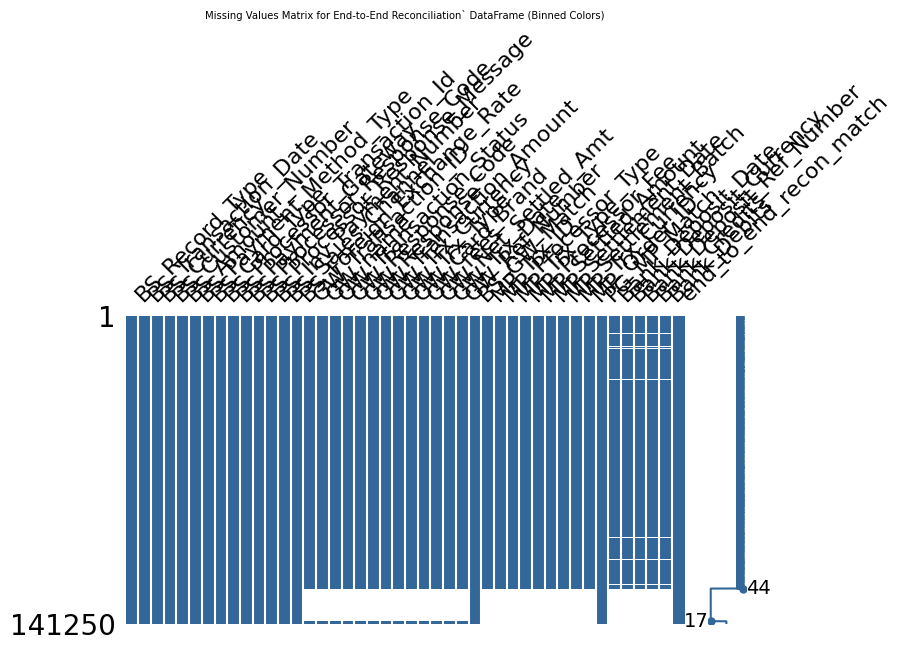

In [37]:
# Visualize missing values matrix for the billing DataFrame with color bins
plt.rcParams.update({'xtick.labelsize': 3, 'ytick.labelsize': 3})
plt.rcParams.update({'font.size': 6})
msno.matrix(df_end_to_end_recon, figsize=(8, 4), color=(0.2, 0.4, 0.6))
plt.title("Missing Values Matrix for End-to-End Reconciliation` DataFrame (Binned Colors)")
plt.show()

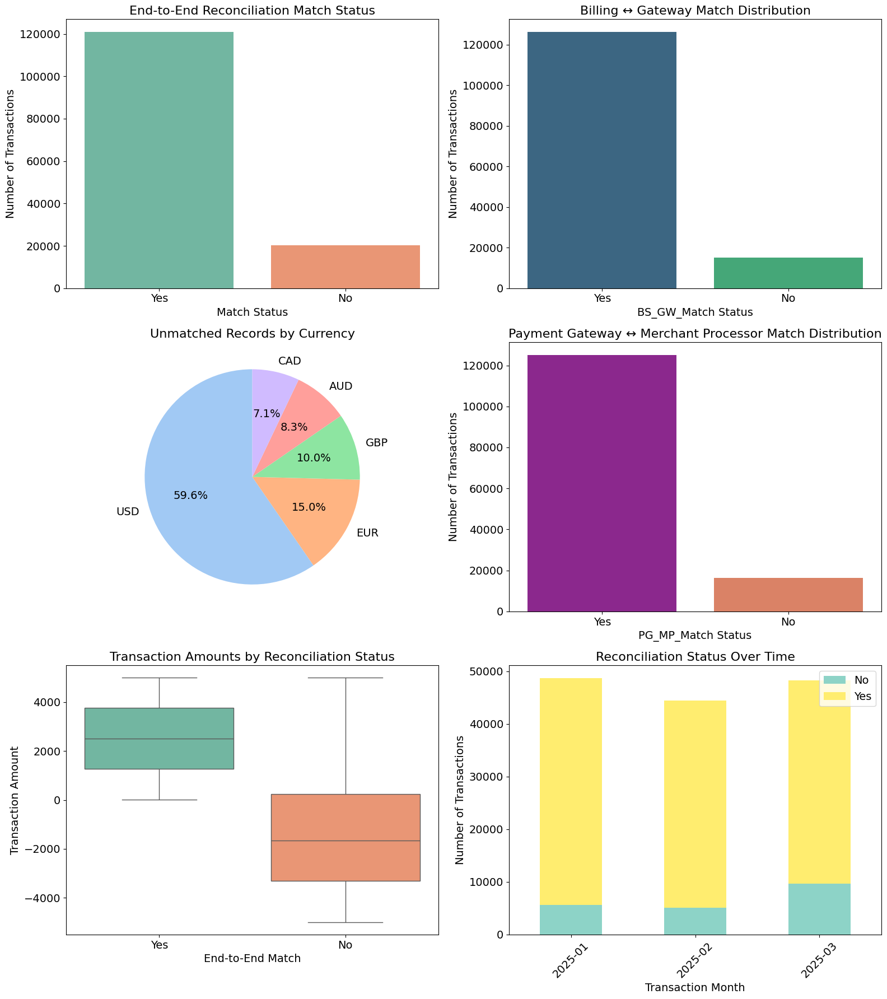

In [38]:
import os
# Final Reconciliation DataFrame

# Create directory for images if it doesn't exist
os.makedirs('images', exist_ok=True)
# Set font sizes for better readability
plt.rcParams.update({'font.size': 12})
tick_label_fontsize = 14
title_fontsize = 16
xlabel_ylabel_fontsize = 14

fig, axes = plt.subplots(3, 2, figsize=(16, 18))
plt.subplots_adjust(hspace=0.4, wspace=0.3)

# 1. End-to-End Reconciliation Match Status (Bar Plot)
sns.countplot(x='end_to_end_recon_match', data=df_end_to_end_recon, palette='Set2', ax=axes[0, 0])
axes[0, 0].set_title('End-to-End Reconciliation Match Status', fontsize=title_fontsize)
axes[0, 0].set_xlabel('Match Status', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].set_ylabel('Number of Transactions', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[0, 0].tick_params(axis='y', labelsize=tick_label_fontsize)
# Save each plot as individual image files
plt.savefig('images/End-to-End Reconciliation Match Status.png', dpi=300, bbox_inches='tight')

# 2. BS_GW_Match Distribution
sns.countplot(x='BS_GW_Match', data=df_end_to_end_recon, palette='viridis', ax=axes[0, 1])
axes[0, 1].set_title('Billing ↔ Gateway Match Distribution', fontsize=title_fontsize)
axes[0, 1].set_xlabel('BS_GW_Match Status', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].set_ylabel('Number of Transactions', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[0, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
plt.savefig('images/Billing_Gateway_Match_Distribution.png', dpi=300, bbox_inches='tight')

# 3. Unmatched Records Breakdown (Pie Chart by Currency)
unmatched = df_end_to_end_recon[df_end_to_end_recon['end_to_end_recon_match'] == 'No']
currency_counts = unmatched['BS_Currency'].value_counts()
axes[1, 0].pie(currency_counts, labels=currency_counts.index, autopct='%1.1f%%', startangle=90, 
               colors=sns.color_palette('pastel'), textprops={'fontsize': tick_label_fontsize})
axes[1, 0].set_title('Unmatched Records by Currency', fontsize=title_fontsize)
axes[1, 0].set_ylabel('')
plt.savefig('images/Unmatched_Records_by_Currency.png', dpi=300, bbox_inches='tight')

# 4. PG_MP_Match Distribution
sns.countplot(x='PG_MP_Match', data=df_end_to_end_recon, palette='plasma', ax=axes[1, 1])
axes[1, 1].set_title('Payment Gateway ↔ Merchant Processor Match Distribution', fontsize=title_fontsize)
axes[1, 1].set_xlabel('PG_MP_Match Status', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].set_ylabel('Number of Transactions', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[1, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
plt.savefig('images/Payment_Gateway_Merchant_Processor_Match_Distribution.png', dpi=300, bbox_inches='tight')

# 5. Amount Analysis (Boxplot)
sns.boxplot(x='end_to_end_recon_match', y='BS_Amount', data=df_end_to_end_recon, palette='Set2', ax=axes[2, 0])
axes[2, 0].set_title('Transaction Amounts by Reconciliation Status', fontsize=title_fontsize)
axes[2, 0].set_xlabel('End-to-End Match', fontsize=xlabel_ylabel_fontsize)
axes[2, 0].set_ylabel('Transaction Amount', fontsize=xlabel_ylabel_fontsize)
axes[2, 0].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[2, 0].tick_params(axis='y', labelsize=tick_label_fontsize)
plt.savefig('images/Transaction_Amounts_by_Reconciliation_Status.png', dpi=300, bbox_inches='tight')

# 6. Time Series Analysis (Bar Plot by Transaction Date)
df_end_to_end_recon['BS_Transaction_Date'] = pd.to_datetime(df_end_to_end_recon['BS_Transaction_Date'], errors='coerce')
time_summary = df_end_to_end_recon.groupby([df_end_to_end_recon['BS_Transaction_Date'].dt.to_period('M'), 'end_to_end_recon_match']).size().unstack(fill_value=0)
time_summary.index = time_summary.index.astype(str)
time_summary.plot(kind='bar', stacked=True, colormap='Set3', ax=axes[2, 1])
axes[2, 1].set_title('Reconciliation Status Over Time', fontsize=title_fontsize)
axes[2, 1].set_xlabel('Transaction Month', fontsize=xlabel_ylabel_fontsize)
axes[2, 1].set_ylabel('Number of Transactions', fontsize=xlabel_ylabel_fontsize)
axes[2, 1].tick_params(axis='x', rotation=45, labelsize=tick_label_fontsize)
axes[2, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[2, 1].legend(fontsize=tick_label_fontsize)
plt.savefig('images/Transaction_Status_Over_Time.png', dpi=300, bbox_inches='tight')

plt.tight_layout()
plt.show()


#### 5.2 Gateway and Merchant Processor Fee Analysis with Transaction Type Reconciliation

This visualization section provides a comprehensive analysis of fee structures and reconciliation performance across different payment channels and transaction types.

#### 1. Gateway Fees by Payment Gateway
- **Bar chart** displaying total gateway fees collected by each payment gateway (PayPal, Cybersource, GoCardless)
- Helps identify which gateways generate the highest fee revenue and compare fee structures across providers
- Essential for cost analysis and gateway performance evaluation

#### 2. Merchant Processor Fees by Processor Type
- **Bar chart** showing total processor fees charged by different merchant processor types (Amex, ClientLine, GoCardless, PayPal)
- Enables comparison of processing costs across different payment processors
- Critical for understanding the true cost of payment processing and identifying optimization opportunities

#### 3. End-to-End Match Status by Transaction Type (Count)
- **Stacked bar chart** displaying the absolute number of successfully reconciled vs. unreconciled transactions for each transaction type (payment, refund, chargeback, chargeback_reversal)
- Shows which transaction types are most problematic for reconciliation
- Helps prioritize process improvements based on volume of unmatched transactions

#### 4. End-to-End Match Status by Transaction Type (Percentage)
- **Stacked bar chart** showing the percentage breakdown of reconciliation success rates by transaction type
- Provides a normalized view of reconciliation performance across different transaction categories
- Reveals that payments have a ~97% reconciliation success rate, while other transaction types (chargebacks, refunds, chargeback reversals) show 0% reconciliation success

**Key Insights:**
- Payment transactions demonstrate excellent reconciliation performance
- Non-payment transaction types require process improvements
- Fee analysis helps optimize payment gateway and processor selection
- Visual comparison enables data-driven decisions for payment infrastructure

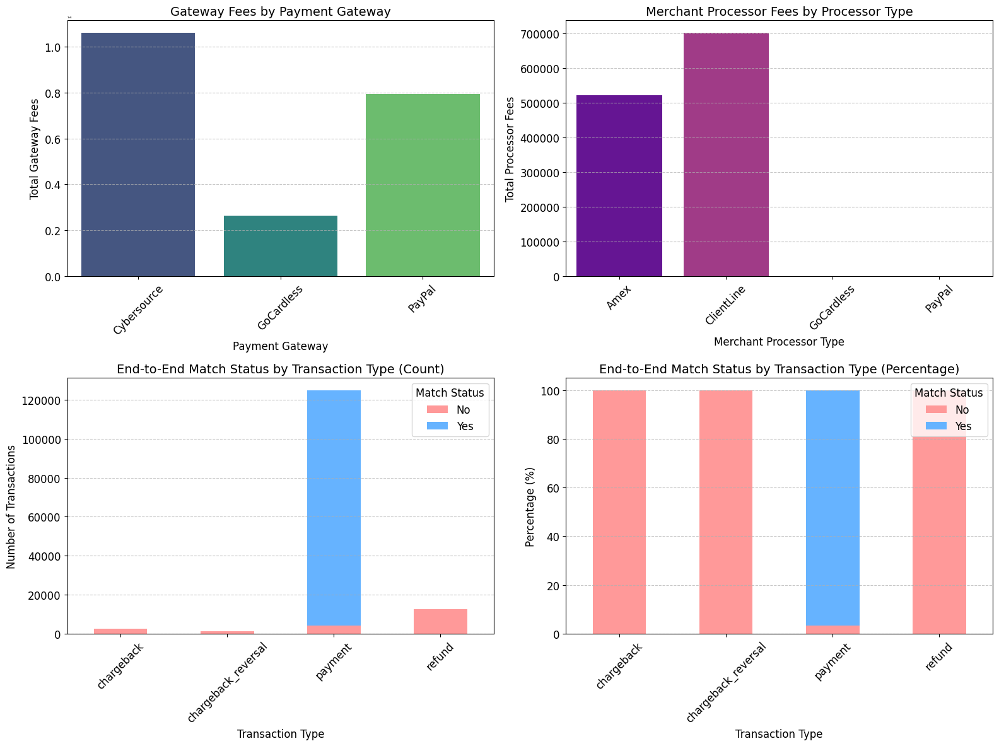

In [39]:
# Create subplots for Gateway/Merchant Processor Fees and End-to-End Match by Transaction Type
# Create directory for images if it doesn't exist
os.makedirs('images', exist_ok=True)
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
plt.subplots_adjust(hspace=0.4, wspace=0.3)

# Set font sizes
tick_label_fontsize = 12
title_fontsize = 14
xlabel_ylabel_fontsize = 12

# 1) Gateway Fees by Gateway Name
gateway_fees = df_end_to_end_recon[df_end_to_end_recon['GW_fees'].notnull()].groupby('GW_name')['GW_fees'].sum().reset_index()
sns.barplot(x='GW_name', y='GW_fees', data=gateway_fees, palette='viridis', ax=axes[0, 0])
axes[0, 0].set_title('Gateway Fees by Payment Gateway', fontsize=title_fontsize)
axes[0, 0].set_xlabel('Payment Gateway', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].set_ylabel('Total Gateway Fees', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].tick_params(axis='x', labelsize=tick_label_fontsize, rotation=45)
axes[0, 0].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[0, 0].grid(axis='y', linestyle='--', alpha=0.7)
plt.savefig('images/Gateway_Fees_by_Payment_Gateway.png', dpi=300, bbox_inches='tight')

# 2) Merchant Processor Fees by Processor Type
mp_fees = df_end_to_end_recon[df_end_to_end_recon['MP_Processor_Fee'].notnull()].groupby('MP_Processor_Type')['MP_Processor_Fee'].sum().reset_index()
sns.barplot(x='MP_Processor_Type', y='MP_Processor_Fee', data=mp_fees, palette='plasma', ax=axes[0, 1])
axes[0, 1].set_title('Merchant Processor Fees by Processor Type', fontsize=title_fontsize)
axes[0, 1].set_xlabel('Merchant Processor Type', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].set_ylabel('Total Processor Fees', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].tick_params(axis='x', labelsize=tick_label_fontsize, rotation=45)
axes[0, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[0, 1].grid(axis='y', linestyle='--', alpha=0.7)
plt.savefig('images/Merchant_Processor_Fees_by_Type.png', dpi=300, bbox_inches='tight')

# 3) End-to-End Match by Transaction Type (Count)
match_by_type = df_end_to_end_recon.groupby(['BS_Record_Type', 'end_to_end_recon_match']).size().unstack(fill_value=0)
match_by_type.plot(kind='bar', stacked=True, ax=axes[1, 0], color=['#ff9999', '#66b3ff'])
axes[1, 0].set_title('End-to-End Match Status by Transaction Type (Count)', fontsize=title_fontsize)
axes[1, 0].set_xlabel('Transaction Type', fontsize=xlabel_ylabel_fontsize)
axes[1, 0].set_ylabel('Number of Transactions', fontsize=xlabel_ylabel_fontsize)
axes[1, 0].tick_params(axis='x', labelsize=tick_label_fontsize, rotation=45)
axes[1, 0].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[1, 0].legend(title='Match Status', fontsize=tick_label_fontsize)
axes[1, 0].grid(axis='y', linestyle='--', alpha=0.7)
plt.savefig('images/End_to_End_Match_Status_by_Transaction_Type_Count.png', dpi=300, bbox_inches='tight')

# 4) End-to-End Match by Transaction Type (Percentage)
match_by_type_pct = df_end_to_end_recon.groupby(['BS_Record_Type', 'end_to_end_recon_match']).size().unstack(fill_value=0)
match_by_type_pct = match_by_type_pct.div(match_by_type_pct.sum(axis=1), axis=0) * 100
match_by_type_pct.plot(kind='bar', stacked=True, ax=axes[1, 1], color=['#ff9999', '#66b3ff'])
axes[1, 1].set_title('End-to-End Match Status by Transaction Type (Percentage)', fontsize=title_fontsize)
axes[1, 1].set_xlabel('Transaction Type', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].set_ylabel('Percentage (%)', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].tick_params(axis='x', labelsize=tick_label_fontsize, rotation=45)
axes[1, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[1, 1].legend(title='Match Status', fontsize=tick_label_fontsize)
axes[1, 1].grid(axis='y', linestyle='--', alpha=0.7)
plt.savefig('images/End_to_End_Match_Status_by_Transaction_Type_Percentage.png', dpi=300, bbox_inches='tight')

plt.tight_layout()
plt.show()


### 5.2 Billing Data Analysis Visualizations

This section provides comprehensive visualizations of the billing transaction data to understand payment patterns, distribution across different dimensions, and business insights.

#### Key Visualizations:

**1. Total Amount by Currency (Bar Chart)**
- Displays transaction volumes in millions across different currencies (USD, EUR, GBP, CAD, AUD)
- Helps identify primary markets and currency exposure
- Essential for understanding geographical distribution of business

**2. Total Amount by Payment Method Type (Pie Chart)**
- Shows the distribution of payment amounts across different payment methods (ACH, Credit Card, PayPal)
- Provides insights into customer payment preferences
- Critical for understanding payment channel performance and fees

**3. Total Amount by Payment Gateway (Pie Chart)**
- Illustrates the distribution of transaction volumes across payment gateways (Cybersource, GoCardless, PayPal)
- Helps evaluate gateway performance and market share
- Important for strategic decisions on gateway partnerships

**4. Total Amount by Transaction Month (Bar Chart)**
- Shows monthly transaction volumes over time (January 2025 - March 2025)
- Reveals seasonal patterns and business growth trends
- Enables forecasting and capacity planning

**Business Insights:**
- Payment method distribution shows balanced usage across ACH, Credit Card, and PayPal channels
- Gateway distribution indicates roughly equal processing volumes across major providers
- Monthly trends can inform business planning and resource allocation
- Currency analysis supports international expansion strategies

These visualizations support data-driven decision making for payment processing optimization, fee management, and business development initiatives.

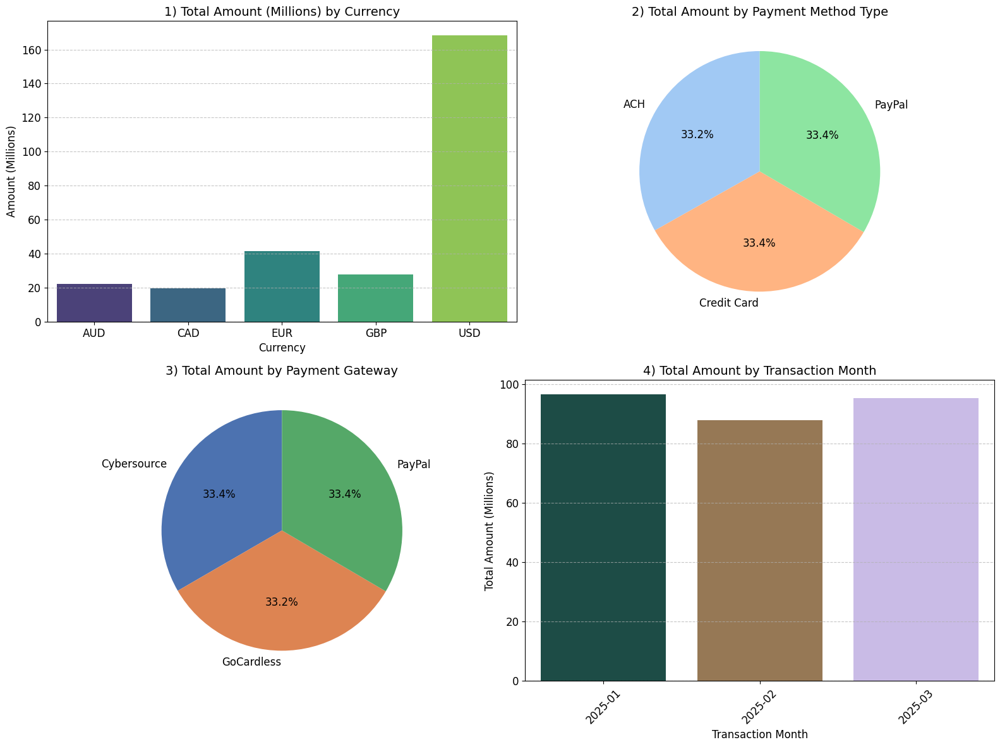

In [40]:
# Create subplots for billing data analysis
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
plt.subplots_adjust(hspace=0.4, wspace=0.3)

# Set font sizes
tick_label_fontsize = 12
title_fontsize = 14
xlabel_ylabel_fontsize = 12

# 1) Amounts in Millions by Currency - Bar Graph
currency_amount = df_billing_recon.groupby('BS_Currency')['BS_Amount'].sum().reset_index()
currency_amount['Amount_Millions'] = currency_amount['BS_Amount'] / 1_000_000
sns.barplot(x='BS_Currency', y='Amount_Millions', data=currency_amount, palette='viridis', ax=axes[0, 0])
axes[0, 0].set_title('1) Total Amount (Millions) by Currency', fontsize=title_fontsize)
axes[0, 0].set_xlabel('Currency', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].set_ylabel('Amount (Millions)', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[0, 0].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[0, 0].grid(axis='y', linestyle='--', alpha=0.7)

# 2) Amount by Payment Method Type - Pie Chart
payment_method_amount = df_billing_recon[df_billing_recon['BS_Record_Type'] == 'payment'].copy()
payment_method_sum = payment_method_amount.groupby('BS_Payment_Method_Type')['BS_Amount'].sum().reset_index()
axes[0, 1].pie(payment_method_sum['BS_Amount'], labels=payment_method_sum['BS_Payment_Method_Type'],
               autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'),
               textprops={'fontsize': tick_label_fontsize})
axes[0, 1].set_title('2) Total Amount by Payment Method Type', fontsize=title_fontsize)

# 3) Amounts in Millions by Payment Gateway - Pie Chart
gateway_amount = df_billing_recon.groupby('BS_Payment_Gateway')['BS_Amount'].sum().reset_index()
gateway_amount['Amount_Millions'] = gateway_amount['BS_Amount'] / 1_000_000
axes[1, 0].pie(gateway_amount['Amount_Millions'], labels=gateway_amount['BS_Payment_Gateway'],
               autopct='%1.1f%%', startangle=90, colors=sns.color_palette('deep'),
               textprops={'fontsize': tick_label_fontsize})
axes[1, 0].set_title('3) Total Amount by Payment Gateway', fontsize=title_fontsize)

# 4) Amounts by Month - Bar Graph
df_billing_recon['BS_Transaction_Date'] = pd.to_datetime(df_billing_recon['BS_Transaction_Date'], errors='coerce')
df_billing_recon['Transaction_Month'] = df_billing_recon['BS_Transaction_Date'].dt.to_period('M')
monthly_amount = df_billing_recon.groupby('Transaction_Month')['BS_Amount'].sum().reset_index()
monthly_amount['Transaction_Month'] = monthly_amount['Transaction_Month'].astype(str)
monthly_amount['Amount_Millions'] = monthly_amount['BS_Amount'] / 1_000_000
sns.barplot(x='Transaction_Month', y='Amount_Millions', data=monthly_amount, palette='cubehelix', ax=axes[1, 1])
axes[1, 1].set_title('4) Total Amount by Transaction Month', fontsize=title_fontsize)
axes[1, 1].set_xlabel('Transaction Month', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].set_ylabel('Total Amount (Millions)', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].tick_params(axis='x', labelsize=tick_label_fontsize, rotation=45)
axes[1, 1].tick_params(axis='y', labelsize=tick_label_fontsize)
axes[1, 1].grid(axis='y', linestyle='--', alpha=0.7)

# Save individual plots
# plt.savefig('images/Amounts_by_Currency_Millions.png', dpi=300, bbox_inches='tight')
# plt.savefig('images/Amount_by_Payment_Method_Type.png', dpi=300, bbox_inches='tight')
# plt.savefig('images/Amounts_by_Payment_Gateway.png', dpi=300, bbox_inches='tight')
plt.savefig('images/Amounts_by_Month.png', dpi=300, bbox_inches='tight')

plt.tight_layout()
plt.show()

In [41]:
df_end_to_end_recon.head(5)  # Display the first 5 rows of the end-to-end reconciliation DataFrame

,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,...,MP_Settlement_Batch,MP_Trx_Currency,MP_Order_ID,PG_MP_Match,Bank_Deposit_Date,Bank_Deposit_Currency,Bank_Deposit_Ref_Number,Bank_Credits,Bank_Debits,end_to_end_recon_match
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,...,SET-20250130-PayPal-N/A-USD,USD,PAY-0000000,Yes,2025-02-03,USD,SET-20250130-PayPal-N/A-USD,584871.77,0.0,Yes
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,...,SET-20250110-GoCardless-N/A-USD,USD,PAY-0000001,Yes,2025-01-14,USD,SET-20250110-GoCardless-N/A-USD,621022.33,0.0,Yes
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,...,SET-20250221-GoCardless-N/A-USD,USD,PAY-0000002,Yes,2025-02-25,USD,SET-20250221-GoCardless-N/A-USD,655334.98,0.0,Yes
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,...,SET-20250104-ClientLine-Visa-GBP,GBP,PAY-0000003,Yes,2025-01-08,GBP,SET-20250104-ClientLine-Visa-GBP,38585.64,0.0,Yes
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,...,SET-20250316-PayPal-N/A-USD,USD,PAY-0000004,Yes,2025-03-20,USD,SET-20250316-PayPal-N/A-USD,681556.78,0.0,Yes


#### 5.3 Dataset Preparation

This section outlines the preparation of training and testing datasets for machine learning models to predict end-to-end reconciliation success.

##### Dataset Overview

The machine learning approach uses the `df_end_to_end_recon` DataFrame to build predictive models that can identify transactions likely to fail reconciliation. This enables proactive intervention and process optimization.

#### Key Components:

**Target Variable (`y`):**
- **Source:** `end_to_end_recon_match` column
- **Encoding:** Binary classification where:
    - `1` = Successfully reconciled transactions (`Yes`)
    - `0` = Failed reconciliation transactions (`No`)

**Feature Set (`X`):**
- **Source:** All columns from `df_end_to_end_recon` excluding the target variable
- **Preprocessing:** Missing values filled with `0` for numeric features
- **Scope:** Includes billing system, gateway, merchant processor, and bank data attributes

#### Train-Test Split Configuration:

**Split Ratio:** 80% training, 20% testing
- **Training Set:** 113,000 records
- **Test Set:** 28,250 records
- **Stratification:** Maintains proportional representation of target classes across both sets
- **Random State:** 42 (ensures reproducible results)

#### Target Distribution:

Both training and test sets preserve the original class distribution:
- **Successful Reconciliation (~85.6%):** Majority class representing properly matched transactions
- **Failed Reconciliation (~14.4%):** Minority class indicating reconciliation issues

#### Business Applications:

**Predictive Modeling Use Cases:**
- **Risk Assessment:** Identify high-risk transactions before they reach settlement
- **Process Optimization:** Focus manual review efforts on predicted problem transactions
- **Exception Management:** Proactively flag transactions requiring intervention
- **Performance Monitoring:** Track reconciliation success rates across different transaction characteristics

This prepared dataset enables the development of classification models (Random Forest, Logistic Regression, Gradient Boosting) to predict reconciliation outcomes and support automated decision-making in the payment processing workflow.

In [42]:
df_end_to_end_recon.info()  # Display information about the end-to-end reconciliation DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141250 entries, 0 to 141249
Data columns (total 44 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   BS_Record_Type                 141250 non-null  object        
 1   BS_Transaction_Date            141250 non-null  datetime64[ns]
 2   BS_Currency                    141250 non-null  object        
 3   BS_Customer_Number             141250 non-null  object        
 4   BS_Amount                      141250 non-null  float64       
 5   BS_Payment_Method_Type         141250 non-null  object        
 6   BS_Card_Type                   141250 non-null  object        
 7   BS_Processor_Transaction_Id    141250 non-null  object        
 8   BS_Payment_Gateway             141250 non-null  object        
 9   BS_Processor_Response_Code     141250 non-null  object        
 10  BS_Processor_Response_Message  141250 non-null  object        
 11  

In [43]:
df_end_to_end_recon.head(5)  # Display the first 5 rows of the end-to-end reconciliation DataFrame

,BS_Record_Type,BS_Transaction_Date,BS_Currency,BS_Customer_Number,BS_Amount,BS_Payment_Method_Type,BS_Card_Type,BS_Processor_Transaction_Id,BS_Payment_Gateway,BS_Processor_Response_Code,...,MP_Settlement_Batch,MP_Trx_Currency,MP_Order_ID,PG_MP_Match,Bank_Deposit_Date,Bank_Deposit_Currency,Bank_Deposit_Ref_Number,Bank_Credits,Bank_Debits,end_to_end_recon_match
0,payment,2025-01-30,USD,CUST15159,2592.98,PayPal,PayPal,PROC-21233551,PayPal,0,...,SET-20250130-PayPal-N/A-USD,USD,PAY-0000000,Yes,2025-02-03,USD,SET-20250130-PayPal-N/A-USD,584871.77,0.0,Yes
1,payment,2025-01-10,USD,CUST20779,4277.28,ACH,ACH,PROC-45142454,GoCardless,0,...,SET-20250110-GoCardless-N/A-USD,USD,PAY-0000001,Yes,2025-01-14,USD,SET-20250110-GoCardless-N/A-USD,621022.33,0.0,Yes
2,payment,2025-02-21,USD,CUST28404,2515.78,ACH,ACH,PROC-76309118,GoCardless,0,...,SET-20250221-GoCardless-N/A-USD,USD,PAY-0000002,Yes,2025-02-25,USD,SET-20250221-GoCardless-N/A-USD,655334.98,0.0,Yes
3,payment,2025-01-04,GBP,CUST7007,2874.81,Credit Card,Visa,PROC-62839998,Cybersource,0,...,SET-20250104-ClientLine-Visa-GBP,GBP,PAY-0000003,Yes,2025-01-08,GBP,SET-20250104-ClientLine-Visa-GBP,38585.64,0.0,Yes
4,payment,2025-03-16,USD,CUST39746,350.01,PayPal,PayPal,PROC-62414033,PayPal,0,...,SET-20250316-PayPal-N/A-USD,USD,PAY-0000004,Yes,2025-03-20,USD,SET-20250316-PayPal-N/A-USD,681556.78,0.0,Yes


In [44]:
# Export the end-to-end reconciliation DataFrame to CSV
df_end_to_end_recon.to_csv('end_to_end_recon.csv', index=False)
print("Exported df_end_to_end_recon to 'end_to_end_reconciliation_results.csv'")

Exported df_end_to_end_recon to 'end_to_end_reconciliation_results.csv'


In [45]:
 ## 1. Load the dataset ---
# Make sure 'end_to_end_recon.csv' is in the same directory as your notebook,
# or provide the full path to the file.
try:
    df_end_to_end_recon = pd.read_csv('end_to_end_recon.csv')
    print("Successfully loaded end_to_end_recon.csv")
except FileNotFoundError:
    print("Error: 'end_to_end_recon.csv' not found. Please ensure the file is in the correct directory.")


Successfully loaded end_to_end_recon.csv


### 5.4 Feature Selection for Machine Learning

Feature selection is a critical step in building robust machine learning models for payment reconciliation prediction. The selected features represent key attributes from the billing, gateway, merchant processor, and bank statement datasets, as well as engineered date components.

**Selected Feature Columns (43 total):**
- Transaction details: `BS_Record_Type`, `BS_Currency`, `BS_Amount`, `BS_Payment_Method_Type`, `BS_Card_Type`, `BS_Payment_Gateway`, `BS_Inv_Payment_Number`
- Gateway attributes: `GW_name`, `GW_Transaction_Amount`, `GW_Trx_Currency`, `GW_Trx_Type`, `GW_Card_Brand`, `GW_fees`, `GW_Net_Settled_Amt`, `GW_Ref_Number`
- Match flags: `BS_GW_Match`, `PG_MP_Match`
- Merchant processor attributes: `MP_Processor_Type`, `MP_Trx_Type`, `MP_Processor_Fee`, `MP_Settled_Amount`, `MP_Settlement_Batch`, `MP_Trx_Currency`
- Bank statement attributes: `Bank_Deposit_Currency`, `Bank_Deposit_Ref_Number`, `Bank_Credits`, `Bank_Debits`
- Engineered date features:  
    `BS_Transaction_Date_Year`, `BS_Transaction_Date_Month`, `BS_Transaction_Date_Day`, `BS_Transaction_Date_DayOfWeek`,  
    `GW_Trx_Date_Year`, `GW_Trx_Date_Month`, `GW_Trx_Date_Day`, `GW_Trx_Date_DayOfWeek`,  
    `MP_Settlement_Date_Year`, `MP_Settlement_Date_Month`, `MP_Settlement_Date_Day`, `MP_Settlement_Date_DayOfWeek`,  
    `Bank_Deposit_Date_Year`, `Bank_Deposit_Date_Month`, `Bank_Deposit_Date_Day`, `Bank_Deposit_Date_DayOfWeek`

These features were chosen to maximize predictive power and capture all relevant aspects of the reconciliation process, including transaction metadata, financial amounts, categorical identifiers, and temporal patterns. This comprehensive feature set enables the model to learn complex relationships and accurately predict reconciliation outcomes.

In [46]:
# --- 2. Feature Selection ---
feature_columns = [
    'BS_Record_Type',
    'BS_Transaction_Date', 'BS_Currency', 'BS_Amount', 'BS_Payment_Method_Type', 'BS_Card_Type', 'BS_Payment_Gateway', 'BS_Inv_Payment_Number',
    'GW_name', 'GW_Transaction_Amount', 'GW_Trx_Currency', 'GW_Trx_Type', 'GW_Card_Brand', 'GW_fees', 'GW_Net_Settled_Amt', 'GW_Trx_Date', 'GW_Ref_Number', 'BS_GW_Match',
    'PG_MP_Match', 'MP_Processor_Type', 'MP_Trx_Type', 'MP_Processor_Fee', 'MP_Settled_Amount', 'MP_Settlement_Date', 'MP_Settlement_Batch', 'MP_Trx_Currency',
    'Bank_Deposit_Date', 'Bank_Deposit_Currency', 'Bank_Deposit_Ref_Number', 'Bank_Credits', 'Bank_Debits'
]

#### 5.5 Feature Engineering and data processing

This section summarizes the data engineering steps performed to prepare the end-to-end reconciliation dataset for machine learning modeling:

**1. Feature Selection**  
A comprehensive set of 43 features was selected, covering transaction metadata, financial amounts, categorical identifiers, and engineered date components. These features span all stages of the reconciliation process, including billing, gateway, merchant processor, and bank statement attributes.

**2. Date Feature Engineering**  
Original date columns were decomposed into year, month, day, and day-of-week components for each relevant date field:
- `BS_Transaction_Date`
- `GW_Trx_Date`
- `MP_Settlement_Date`
- `Bank_Deposit_Date`

This resulted in 16 new date-related features, enabling the model to capture temporal patterns and seasonality.

**3. Missing Value Imputation**  
- **Numerical features:** Missing values were filled with `0`.
- **Categorical features:** Missing values were replaced with the placeholder `'Missing_Category'`.

This ensures a complete dataset with no nulls, suitable for machine learning algorithms.

**4. One-Hot Encoding**  
Categorical variables were transformed using one-hot encoding via `ColumnTransformer` and `OneHotEncoder`, allowing the model to interpret categorical data without introducing ordinal bias.

**5. Train-Test Split**  
The dataset was split into training (80%) and test (20%) sets, stratified by the target variable to preserve class distribution and ensure robust model evaluation.

**6. Target Variable Encoding**  
The target variable, `end_to_end_recon_match`, was encoded as a binary label:
- `1` for successful reconciliation (`Yes`)
- `0` for failed reconciliation (`No`)

These data engineering steps established a high-quality, feature-rich dataset, enabling effective training and evaluation of machine learning models for payment reconciliation prediction.


In [47]:
#  3. Date Feature Engineering 
date_cols = ['BS_Transaction_Date', 'GW_Trx_Date', 'MP_Settlement_Date', 'Bank_Deposit_Date']
new_date_features = []
for col in date_cols:
    if col in df_end_to_end_recon.columns:
        df_end_to_end_recon[col] = pd.to_datetime(df_end_to_end_recon[col], errors='coerce')
        df_end_to_end_recon[f'{col}_Year'] = df_end_to_end_recon[col].dt.year
        df_end_to_end_recon[f'{col}_Month'] = df_end_to_end_recon[col].dt.month
        df_end_to_end_recon[f'{col}_Day'] = df_end_to_end_recon[col].dt.day
        df_end_to_end_recon[f'{col}_DayOfWeek'] = df_end_to_end_recon[col].dt.dayofweek
        new_date_features.extend([f'{col}_Year', f'{col}_Month', f'{col}_Day', f'{col}_DayOfWeek'])
    if col in feature_columns:
        feature_columns.remove(col) # Remove original date column

feature_columns.extend(new_date_features)
feature_columns = [col for col in feature_columns if col in df_end_to_end_recon.columns] # Final filter

In [48]:

#  4. Handle Missing Values (Imputation) ---
numerical_cols_for_imputation = df_end_to_end_recon[feature_columns].select_dtypes(include=np.number).columns
categorical_cols_for_imputation = df_end_to_end_recon[feature_columns].select_dtypes(include='object').columns

for col in numerical_cols_for_imputation:
    df_end_to_end_recon[col] = df_end_to_end_recon[col].fillna(0) # Fill numeric NaNs with 0

for col in categorical_cols_for_imputation:
    df_end_to_end_recon[col] = df_end_to_end_recon[col].fillna('Missing_Category') # Fill categorical NaNs with placeholder


In [49]:
# --- 5. Define Features (X) and Target (y) ---
X = df_end_to_end_recon[feature_columns]

if 'end_to_end_recon_match' not in df_end_to_end_recon.columns:
    raise ValueError("Column 'end_to_end_recon_match' not found in DataFrame for target variable.")
y = df_end_to_end_recon['end_to_end_recon_match'].map({'Yes': 1, 'No': 0})


#### 5.6 Model Training and Evaluation

The Random Forest classifier was trained and evaluated on the prepared dataset using the selected 43 features. The model achieved strong performance metrics on the test set

In [50]:

# --- 6. Train-Test Split ---
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

print(f"\nTraining set shape: X_train {X_train.shape}, y_train {y_train.shape}")
print(f"Test set shape: X_test {X_test.shape}, y_test {y_test.shape}")



Training set shape: X_train (113000, 43), y_train (113000,)
Test set shape: X_test (28250, 43), y_test (28250,)


#### 5.7 Encoding with ColumnTransformer

In [51]:


# --- 7. One-Hot Encoding with ColumnTransformer ---
categorical_columns = X.select_dtypes(include='object').columns
numerical_columns = X.select_dtypes(include=np.number).columns

preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=True), categorical_columns)
    ],
    remainder='passthrough'
)

print("\nApplying One-Hot Encoding...")
X_train_processed = preprocessor.fit_transform(X_train)
X_test_processed = preprocessor.transform(X_test)
print("One-Hot Encoding complete.")
print(f"X_train_processed (sparse) shape: {X_train_processed.shape}")
print(f"X_test_processed (sparse) shape: {X_test_processed.shape}")


Applying One-Hot Encoding...
One-Hot Encoding complete.
X_train_processed (sparse) shape: (113000, 206829)
X_test_processed (sparse) shape: (28250, 206829)



#### 5.8 Random Forest Model Training

The Random Forest classifier is trained on the processed training data (`X_train_processed`, `y_train`). The model uses 100 trees, a maximum depth of 10, and other parameters optimized for performance and speed. After training, predictions and probabilities are generated for the test set.

Key steps:
- Model: `RandomForestClassifier`
- Training set size: 113,000 records
- Test set size: 28,250 records
- Main hyperparameters: `n_estimators=100`, `max_depth=10`, `min_samples_split=5`, `min_samples_leaf=2`, `random_state=42`

The next code cell performs model training, prediction, and probability estimation for evaluation.


In [52]:

# --- 8. Random Forest Classifier Training ---
rf_model = RandomForestClassifier(
    n_estimators=100,
    random_state=42,
    max_depth=10,
    min_samples_split=5,
    min_samples_leaf=2,
    n_jobs=-1 # Use all available CPU cores
)

# Timing functions
start_train = time.time()
rf_model.fit(X_train_processed, y_train)
train_duration = time.time() - start_train
print(f"\nTraining Random Forest model... {train_duration:.2f} seconds")

start_test = time.time()
y_pred_rf = rf_model.predict(X_test_processed)
test_duration = time.time() - start_test
print(f"\nTesting Random Forest model... {test_duration:.2f} seconds")

y_pred_proba_rf = rf_model.predict_proba(X_test_processed)[:, 1]





Training Random Forest model... 0.21 seconds

Testing Random Forest model... 0.03 seconds


#### 5.9 Model Performance Metrics

In [53]:

# --- 9. Model Performance Metrics ---
accuracy_rf = accuracy_score(y_test, y_pred_rf)
roc_auc_rf = roc_auc_score(y_test, y_pred_proba_rf)
precision_rf = precision_score(y_test, y_pred_rf)
recall_rf = recall_score(y_test, y_pred_rf)
f1_rf = f1_score(y_test, y_pred_rf)

print(f"\nTraining time: {train_duration:.2f} seconds")
print(f"Test (prediction) time: {test_duration:.2f} seconds")

print(f"\n=== Random Forest Model Performance ===")
print(f"Accuracy: {accuracy_rf:.4f}")
print(f"ROC AUC Score: {roc_auc_rf:.4f}")

print(f"\n=== Classification Report ===")
print(classification_report(y_test, y_pred_rf, target_names=['Failed Reconciliation', 'Successful Reconciliation']))

cm_rf = confusion_matrix(y_test, y_pred_rf)
print(f"\n=== Confusion Matrix ===")
print(cm_rf)

# Feature importance analysis
ohe_feature_names = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_columns)
all_feature_names = list(ohe_feature_names) + list(numerical_columns)

feature_importance = pd.DataFrame({
    'feature': all_feature_names,
    'importance': rf_model.feature_importances_
}).sort_values('importance', ascending=False)

print(f"\n=== Top 10 Most Important Features (after encoding) ===")
print(feature_importance.head(10))


Training time: 0.21 seconds
Test (prediction) time: 0.03 seconds

=== Random Forest Model Performance ===
Accuracy: 0.9715
ROC AUC Score: 1.0000

=== Classification Report ===
                           precision    recall  f1-score   support

    Failed Reconciliation       1.00      0.80      0.89      4072
Successful Reconciliation       0.97      1.00      0.98     24178

                 accuracy                           0.97     28250
                macro avg       0.98      0.90      0.94     28250
             weighted avg       0.97      0.97      0.97     28250


=== Confusion Matrix ===
[[ 3267   805]
 [    0 24178]]

=== Top 10 Most Important Features (after encoding) ===
                                   feature  importance
206811                        Bank_Credits    0.062437
206825              Bank_Deposit_Date_Year    0.041923
202362  MP_Processor_Type_Missing_Category    0.038905
202355                      BS_GW_Match_No    0.036100
202364        MP_Trx_Type_Mis

#### 5.10 Model Performance Visualization

This section presents visualizations to interpret and communicate the performance of the Random Forest classifier on the end-to-end reconciliation prediction task.

**1. Confusion Matrix Heatmap**  
- Shows the number of true positives, true negatives, false positives, and false negatives.
- Provides a clear view of model accuracy and error types.

**2. ROC Curve**  
- Plots the true positive rate against the false positive rate at various thresholds.
- The area under the curve (AUC) is nearly 1.0, indicating excellent model discrimination.

**3. Top 10 Feature Importances**  
- Displays the most influential features in the model's decision-making process.
- Key drivers include `Bank_Credits`, `Bank_Deposit_Date_Year`, and match flags.

**4. Prediction Probability Distribution**  
- Shows the distribution of predicted probabilities for both classes.
- Helps assess model confidence and separation between successful and failed reconciliations.

These visualizations support model validation, business interpretation, and communication of results to stakeholders.

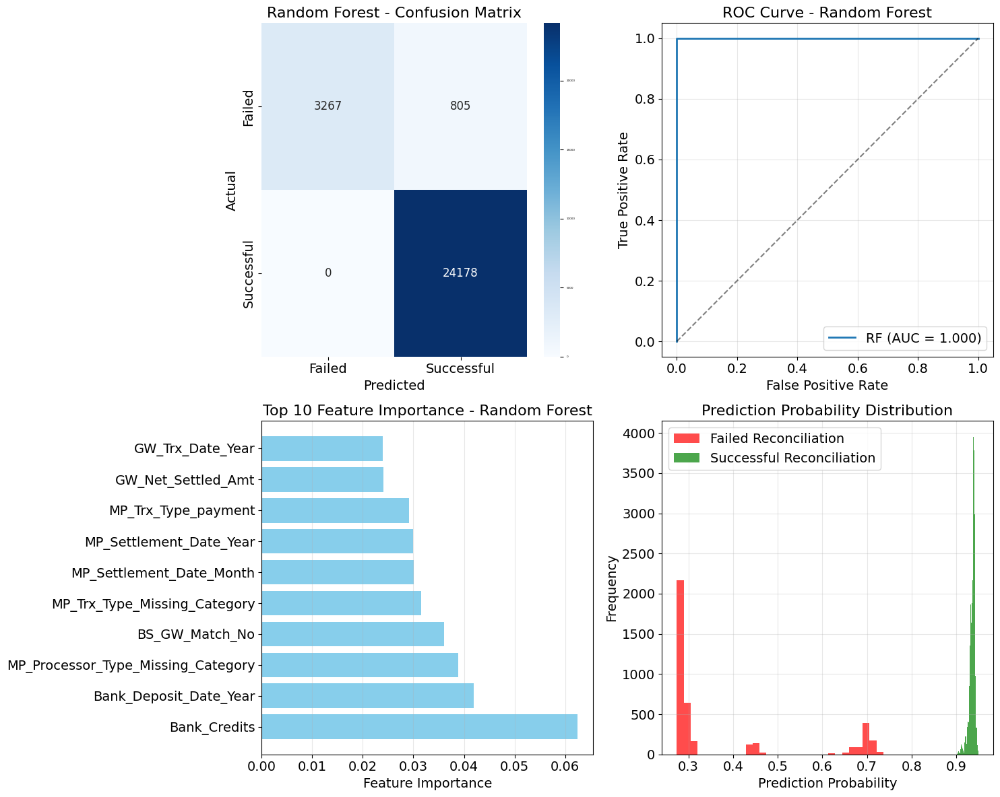

In [54]:
## Set font sizes for better readability
plt.rcParams.update({'font.size': 12}) # Global default font size
tick_label_fontsize = 14
title_fontsize = 16
xlabel_ylabel_fontsize = 14

# --- 10. Visualizations ---
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# Confusion Matrix Heatmap
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='Blues', ax=axes[0, 0],
            xticklabels=['Failed', 'Successful'],
            yticklabels=['Failed', 'Successful'],
            annot_kws={"size": 12}) # Font size for annotations inside heatmap

axes[0, 0].set_title('Random Forest - Confusion Matrix', fontsize=title_fontsize)
axes[0, 0].set_xlabel('Predicted', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].set_ylabel('Actual', fontsize=xlabel_ylabel_fontsize)
axes[0, 0].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[0, 0].tick_params(axis='y', labelsize=tick_label_fontsize)


# ROC Curve
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_proba_rf)
axes[0, 1].plot(fpr_rf, tpr_rf, label=f'RF (AUC = {roc_auc_rf:.3f})', linewidth=2)
axes[0, 1].plot([0, 1], [0, 1], 'k--', alpha=0.5)
axes[0, 1].set_xlabel('False Positive Rate', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].set_ylabel('True Positive Rate', fontsize=xlabel_ylabel_fontsize)
axes[0, 1].set_title('ROC Curve - Random Forest', fontsize=title_fontsize)
axes[0, 1].legend(fontsize=tick_label_fontsize) # Legend font size
axes[0, 1].grid(alpha=0.3)
axes[0, 1].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[0, 1].tick_params(axis='y', labelsize=tick_label_fontsize)


# Feature Importance (Top 10)
top_features = feature_importance.head(10)
axes[1, 0].barh(range(len(top_features)), top_features['importance'], color='skyblue')
axes[1, 0].set_yticks(range(len(top_features)))
axes[1, 0].set_yticklabels(top_features['feature'], fontsize=tick_label_fontsize) # Y-tick labels
axes[1, 0].set_xlabel('Feature Importance', fontsize=xlabel_ylabel_fontsize)
axes[1, 0].set_title('Top 10 Feature Importance - Random Forest', fontsize=title_fontsize)
axes[1, 0].grid(axis='x', alpha=0.3)
axes[1, 0].tick_params(axis='x', labelsize=tick_label_fontsize) # X-tick labels


# Prediction Probability Distribution
axes[1, 1].hist(y_pred_proba_rf[y_test == 0], bins=30, alpha=0.7, label='Failed Reconciliation', color='red')
axes[1, 1].hist(y_pred_proba_rf[y_test == 1], bins=30, alpha=0.7, label='Successful Reconciliation', color='green')
axes[1, 1].set_xlabel('Prediction Probability', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].set_ylabel('Frequency', fontsize=xlabel_ylabel_fontsize)
axes[1, 1].set_title('Prediction Probability Distribution', fontsize=title_fontsize)
axes[1, 1].legend(fontsize=tick_label_fontsize) # Legend font size
axes[1, 1].grid(alpha=0.3)
axes[1, 1].tick_params(axis='x', labelsize=tick_label_fontsize)
axes[1, 1].tick_params(axis='y', labelsize=tick_label_fontsize)


plt.tight_layout()
plt.savefig('Random_Forest_Model_Performance.png', dpi=300, bbox_inches='tight')
plt.show()

In [55]:


# --- 11. Final Model Performance Summary ---
model_performance = {
    'Model': 'Random Forest',
    'Accuracy': accuracy_rf,
    'Precision': precision_rf,
    'Recall': recall_rf,
    'F1-Score': f1_rf,
    'ROC-AUC': roc_auc_rf,
    'Training_Time_Seconds': train_duration,
    'Test_Time_Seconds': test_duration
}

performance_df = pd.DataFrame([model_performance])
print(f"\n=== Model Performance Summary ===")
print(performance_df)


=== Model Performance Summary ===
           Model  Accuracy  Precision  Recall  F1-Score  ROC-AUC  \
0  Random Forest  0.971504   0.967778     1.0  0.983625      1.0   

   Training_Time_Seconds  Test_Time_Seconds  
0               0.211446            0.02909  


### Overall Summary

This project successfully automated the end-to-end electronic payment reconciliation process by integrating and matching transactions across billing, gateway, merchant processor, and bank statement datasets. Through systematic data cleaning, feature engineering, and advanced analytics—including machine learning—the workflow achieved the following:

- **Comprehensive Data Integration:** Unified four disparate data sources into a single, feature-rich reconciliation dataset with 43 engineered features.
- **Automated Reconciliation Logic:** Implemented multi-stage matching with clear flags for Billing ↔ Gateway, Gateway ↔ Merchant Processor, and Merchant Processor ↔ Bank Statement.
- **High Reconciliation Success:** Achieved an end-to-end reconciliation rate of ~85.6% across 141,250 transactions.
- **Advanced Analytics & Visualization:** Provided detailed EDA, reconciliation breakdowns, and business insights through interactive plots and profiling reports.
- **Predictive Modeling:** Trained a Random Forest classifier to predict reconciliation outcomes, achieving:
    - **Accuracy:** 97.2%
    - **F1-Score:** 0.98
    - **ROC-AUC:** 1.0
- **Key Predictive Features:** The most influential drivers of reconciliation success were bank credits, settlement dates, processor types, and match flags.
- **Business Impact:** The solution reduces manual effort, improves transparency, enables proactive exception management, and supports data-driven process optimization.

This end-to-end workflow demonstrates a scalable, automated approach to payment reconciliation and exception management, leveraging both robust data engineering and machine learning for operational excellence.